# Library Imports

In [1]:
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import warnings
from bs4 import BeautifulSoup
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk
import math
import time
import re
import os
import seaborn as sns
from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity  
from sklearn.metrics import pairwise_distances
from matplotlib import gridspec
from scipy.sparse import hstack
import plotly
import plotly.figure_factory as ff
from plotly.graph_objs import Scatter, Layout

plotly.offline.init_notebook_mode(connected=True)
warnings.filterwarnings("ignore")

C:\Users\MILIN\anaconda3\envs\fastai\lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [2]:
data = pd.read_json('tops_fashion.json')

In [3]:
print('Number of data Points: ' , data.shape[0])
print('Numbers of features: ',data.shape[1])

Number of data Points:  183138
Numbers of features:  19


In [4]:
data.columns

Index(['sku', 'asin', 'product_type_name', 'formatted_price', 'author',
       'color', 'brand', 'publisher', 'availability', 'reviews',
       'large_image_url', 'availability_type', 'small_image_url',
       'editorial_review', 'title', 'model', 'medium_image_url',
       'manufacturer', 'editorial_reivew'],
      dtype='object')

* only using 6 featurs
1. asin (Amazon standard identification Number)
2. Brand
3. Color
4. Product type name
5. medium image url
6. Formatted price
7. title

In [5]:
data = data[['asin', 'brand','color', 'medium_image_url', 'product_type_name', 'formatted_price', 'title']]

In [7]:
data.head()

,asin,brand,color,medium_image_url,product_type_name,formatted_price,title
0,B016I2TS4W,FNC7C,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,None,Minions Como Superheroes Ironman Long Sleeve R...
1,B01N49AI08,FIG Clothing,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,None,FIG Clothing Womens Izo Tunic
2,B01JDPCOHO,FIG Clothing,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,None,FIG Clothing Womens Won Top
3,B01N19U5H5,Focal18,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,None,Focal18 Sailor Collar Bubble Sleeve Blouse Shi...
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,$26.26,Featherlite Ladies' Long Sleeve Stain Resistan...


In [8]:
print('Number of data Points: ' , data.shape[0])
print('Numbers of features: ',data.shape[1])

Number of data Points:  183138
Numbers of features:  7


# Data Cleaning

## Price Missing, Color Missing, Product type name

In [10]:
print(data['product_type_name'].describe())

count     183138
unique        72
top        SHIRT
freq      167794
Name: product_type_name, dtype: object


### Inference :  (As data obtained is of women shirts)
- 72 unique categories 
- Shirt consists of 92.61% of data

In [11]:
print(data['product_type_name'].unique())

['SHIRT' 'SWEATER' 'APPAREL' 'OUTDOOR_RECREATION_PRODUCT'
 'BOOKS_1973_AND_LATER' 'PANTS' 'HAT' 'SPORTING_GOODS' 'DRESS' 'UNDERWEAR'
 'SKIRT' 'OUTERWEAR' 'BRA' 'ACCESSORY' 'ART_SUPPLIES' 'SLEEPWEAR'
 'ORCA_SHIRT' 'HANDBAG' 'PET_SUPPLIES' 'SHOES' 'KITCHEN' 'ADULT_COSTUME'
 'HOME_BED_AND_BATH' 'MISC_OTHER' 'BLAZER' 'HEALTH_PERSONAL_CARE'
 'TOYS_AND_GAMES' 'SWIMWEAR' 'CONSUMER_ELECTRONICS' 'SHORTS' 'HOME'
 'AUTO_PART' 'OFFICE_PRODUCTS' 'ETHNIC_WEAR' 'BEAUTY'
 'INSTRUMENT_PARTS_AND_ACCESSORIES' 'POWERSPORTS_PROTECTIVE_GEAR' 'SHIRTS'
 'ABIS_APPAREL' 'AUTO_ACCESSORY' 'NONAPPARELMISC' 'TOOLS' 'BABY_PRODUCT'
 'SOCKSHOSIERY' 'POWERSPORTS_RIDING_SHIRT' 'EYEWEAR' 'SUIT'
 'OUTDOOR_LIVING' 'POWERSPORTS_RIDING_JACKET' 'HARDWARE' 'SAFETY_SUPPLY'
 'ABIS_DVD' 'VIDEO_DVD' 'GOLF_CLUB' 'MUSIC_POPULAR_VINYL'
 'HOME_FURNITURE_AND_DECOR' 'TABLET_COMPUTER' 'GUILD_ACCESSORIES'
 'ABIS_SPORTS' 'ART_AND_CRAFT_SUPPLY' 'BAG' 'MECHANICAL_COMPONENTS'
 'SOUND_AND_RECORDING_EQUIPMENT' 'COMPUTER_COMPONENT' 'JEWELRY'
 'B

### 10 most frequent product types

In [13]:
product_type_count = Counter(list(data['product_type_name']))
product_type_count.most_common(10)

[('SHIRT', 167794),
 ('APPAREL', 3549),
 ('BOOKS_1973_AND_LATER', 3336),
 ('DRESS', 1584),
 ('SPORTING_GOODS', 1281),
 ('SWEATER', 837),
 ('OUTERWEAR', 796),
 ('OUTDOOR_RECREATION_PRODUCT', 729),
 ('ACCESSORY', 636),
 ('UNDERWEAR', 425)]

### Analysis on Brands

In [14]:
print(data['brand'].describecribe())

count     182987
unique     10577
top         Zago
freq         223
Name: brand, dtype: object


#### Observation
- unique brands - 10577
- Top Brand - Zago (223 rows)

In [15]:
brand_count = Counter(list(data['brand']))
brand_count.most_common(10)

[('Zago', 223),
 ('XQS', 222),
 ('Yayun', 215),
 ('YUNY', 198),
 ('XiaoTianXin-women clothes', 193),
 ('Generic', 192),
 ('Boohoo', 190),
 ('Alion', 188),
 ('Abetteric', 187),
 ('TheMogan', 187)]

### Color 

In [16]:
print(data['color'].describe())

count     64956
unique     7380
top       Black
freq      13207
Name: color, dtype: object


In [17]:
color_count = Counter(list(data['color']))
color_count.most_common(10)

[(None, 118182),
 ('Black', 13207),
 ('White', 8616),
 ('Blue', 3570),
 ('Red', 2289),
 ('Pink', 1842),
 ('Grey', 1499),
 ('*', 1388),
 ('Green', 1258),
 ('Multi', 1203)]

 Most rows dont have color

### Formatted Price 

In [19]:
print(data['formatted_price'].describe())

count      28395
unique      3135
top       $19.99
freq         945
Name: formatted_price, dtype: object


In [20]:
formatted_price_count = Counter(list(data['formatted_price']))
formatted_price_count.most_common(10)

[(None, 154743),
 ('$19.99', 945),
 ('$9.99', 749),
 ('$9.50', 601),
 ('$14.99', 472),
 ('$7.50', 463),
 ('$24.99', 414),
 ('$29.99', 370),
 ('$8.99', 343),
 ('$9.01', 336)]

In [21]:
#### Only 15% of the data have price information

### Title 

In [22]:
print(data['title'].describe())

count                                                183138
unique                                               175985
top       Nakoda Cotton Self Print Straight Kurti For Women
freq                                                     77
Name: title, dtype: object


In [23]:
title_count = Counter(list(data['title']))
title_count.most_common(10)

[('Nakoda Cotton Self Print Straight Kurti For Women', 77),
 ("Q-rious Women's Racerback Cotton Lycra Camsioles", 56),
 ('FINEJO Casual Women Long Sleeve Lace Irregular Hem Blouse Tops', 47),
 ('Girlzwalk Women Cami Sleeveless Printed Swing Vest Top Plus Sizes', 44),
 ("ELINA FASHION Women's Indo-Western Tunic Top Cotton Kurti", 43),
 ('Victoria Scoop Neck Front Lace Floral High-Low Top in 4 Sizes', 40),
 ("Cenizas Women's Indian Tunic Top Cotton Kurti", 39),
 ('Indistar Womens Premium Cotton Half Sleeves Printed T-Shirts/Tops (Pack of 3)',
  37),
 ("Rajnandini Women's Cotton Printed Kurti", 35),
 ('Long Sleeve Mock Neck Top', 32)]

In [24]:
#### All products have title
#### Most informative

In [27]:
data.to_pickle('pickels/180k_apparel_data')

## pickle saves data to the disc

## Making data small

###  Removing null price data

In [28]:
data = data.loc[~data['formatted_price'].isnull()]
print('Number of data points after eliminating price=Null: ', data.shape[0])

Number of data points after eliminating price=Null:  28395


### Removing null color data

In [30]:
data = data.loc[~data['color'].isnull()]
print('Number of data points after eliminating color=Null: ', data.shape[0])

Number of data points after eliminating color=Null:  28385


In [31]:
#### 183k --> 28k

In [32]:
data.to_pickle('pickels/28k_apparel_data')

## See Images using medium url 

In [40]:
## Takes too much time 

# from PIL import Image
# import requests
# from io import BytesIO

# for index, row in data.iterrows():
#     url = row['medium_image_url']
#     response = requests.get(url)
#     img = Image.open(BytesIO(response.content))
#     img.save('images/28k_images/'+row['asin'] + '.jpeg')

## Remove Duplicate data

In [41]:
data = pd.read_pickle('pickels/28k_apparel_data')

In [42]:
print(sum(data.duplicated('title')))

2325


In [45]:
### This data are of shirts which are exactly same except in size (S,M,L, XL)
### or have exact same product with different colors

In [46]:
### Remove duplicates dedup

### Remove duplicates part-1

In [47]:
data_sorted = data[data['title'].apply(lambda x: len(x.split()) > 4)]
print('After removal of products with short description: ', data_sorted.shape[0])

After removal of products with short description:  27949


In [48]:
data_sorted.sort_values('title', inplace=True, ascending=False)
data_sorted.head()

,asin,brand,color,medium_image_url,product_type_name,formatted_price,title
61973,B06Y1KZ2WB,Éclair,Black/Pink,https://images-na.ssl-images-amazon.com/images...,SHIRT,$24.99,Éclair Women's Printed Thin Strap Blouse Black...
133820,B010RV33VE,xiaoming,Pink,https://images-na.ssl-images-amazon.com/images...,SHIRT,$18.19,xiaoming Womens Sleeveless Loose Long T-shirts...
81461,B01DDSDLNS,xiaoming,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,$21.58,xiaoming Women's White Long Sleeve Single Brea...
75995,B00X5LYO9Y,xiaoming,Red Anchors,https://images-na.ssl-images-amazon.com/images...,SHIRT,$15.91,xiaoming Stripes Tank Patch/Bear Sleeve Anchor...
151570,B00WPJG35K,xiaoming,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,$14.32,xiaoming Sleeve Sheer Loose Tassel Kimono Woma...


In [51]:
## Titles differing only in some last words

### Ex. 
# tokodoki The Queen of Diamonds Women's Shirt X-Large
# tokodoki The Queen of Diamonds Women's Shirt X-small
# tokodoki The Queen of Diamonds Women's Shirt Medium

In [52]:
indices = []
for i,row in data_sorted.iterrows():
    indices.append(i)

In [53]:
import itertools
stage1_dedupe_asins = []
i = 0
j = 0
num_data_points = data_sorted.shape[0]
while i < num_data_points and j < num_data_points:
    
    previous_i = i

    # store the list of words of ith string in a, ex: a = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
    a = data['title'].loc[indices[i]].split()

    # search for the similar products sequentially 
    j = i+1
    while j < num_data_points:

        # store the list of words of jth string in b, ex: b = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'Small']
        b = data['title'].loc[indices[j]].split()

        # store the maximum length of two strings
        length = max(len(a), len(b))

        # count is used to store the number of words that are matched in both strings
        count  = 0

        # itertools.zip_longest(a,b): will map the corresponding words in both strings, it will appened None in case of unequal strings
        # example: a =['a', 'b', 'c', 'd']
        # b = ['a', 'b', 'd']
        # itertools.zip_longest(a,b): will give [('a','a'), ('b','b'), ('c','d'), ('d', None)]
        for k in itertools.zip_longest(a,b): 
            if (k[0] == k[1]):
                count += 1

        # if the number of words in which both strings differ are > 2 , we are considering it as those two apperals are different
        # if the number of words in which both strings differ are < 2 , we are considering it as those two apperals are same, hence we are ignoring them
        if (length - count) > 2: # number of words in which both sensences differ
            # if both strings are differ by more than 2 words we include the 1st string index
            stage1_dedupe_asins.append(data_sorted['asin'].loc[indices[i]])

            # if the comaprision between is between num_data_points, num_data_points-1 strings and they differ in more than 2 words we include both
            if j == num_data_points-1: stage1_dedupe_asins.append(data_sorted['asin'].loc[indices[j]])

            # start searching for similar apperals corresponds 2nd string
            i = j
            break
        else:
            j += 1
    if previous_i == i:
        break

In [54]:
data = data = data.loc[data['asin'].isin(stage1_dedupe_asins)]

In [57]:
## We removed the duplicates which differ only at the end

In [58]:
print('Number of data points: ',data.shape[0] )

Number of data points:  17593


In [59]:
data.to_pickle('pickels/17k_apparel_data')

### Remove duplicates part-1

In [62]:
## some title are very similar with synonyms  ---> women == Ladies
#### cool == unique == new

In [63]:
data = pd.read_pickle('pickels/17k_apparel_data')


In [67]:
### Find how titles differ in no of words  (nC2)  -->for 17k title --  154 millions = 15.4 crores


## For 183k title this has 16.7 billion comparisions to make

### Brute Force 

In [68]:
# To remove duplicate titles not sorted alphabetically
# This code snippet takes significant amount of time.
# O(n^2) time.
# Takes about an hour to run on a decent computer.
import itertools
indices = []
for i,row in data.iterrows():
    indices.append(i)

stage2_dedupe_asins = []
while len(indices)!=0:
    i = indices.pop()
    stage2_dedupe_asins.append(data['asin'].loc[i])
    # consider the first apperal's title
    a = data['title'].loc[i].split()
    # store the list of words of ith string in a, ex: a = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
    for j in indices:
        
        b = data['title'].loc[j].split()
        # store the list of words of jth string in b, ex: b = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
        
        length = max(len(a),len(b))
        
        # count is used to store the number of words that are matched in both strings
        count  = 0

        # itertools.zip_longest(a,b): will map the corresponding words in both strings, it will appened None in case of unequal strings
        # example: a =['a', 'b', 'c', 'd']
        # b = ['a', 'b', 'd']
        # itertools.zip_longest(a,b): will give [('a','a'), ('b','b'), ('c','d'), ('d', None)]
        for k in itertools.zip_longest(a,b): 
            if (k[0]==k[1]):
                count += 1

        # if the number of words in which both strings differ are < 3 , we are considering it as those two apperals are same, hence we are ignoring them
        if (length - count) < 3:
            indices.remove(j)

*** Use Inverted Indexes to compute # of different words amongst out titles

In [70]:
data = data.loc[data['asin'].isin(stage2_dedupe_asins)]

In [71]:
print('Number of data points after stage two of dedupe: ', data.shape[0])

Number of data points after stage two of dedupe:  16435


In [72]:
data.to_pickle('pickels/16k_apparel_data')

# Text PreProcessing

In [73]:
data = pd.read_pickle('pickels/16k_apparel_data')

In [75]:
# import nltk
# nltk.download()

## Stop Word Removal

In [76]:
stop_words = set(stopwords.words('english'))

In [78]:
print('list of stop_words : ', stop_words)


list of stop_words :  {'or', "couldn't", "she's", 'until', 'here', 'doing', 'nor', 'its', 'being', 'after', 'do', 'itself', 'her', 'don', 'had', "doesn't", 'an', 'd', "don't", "wasn't", "hadn't", 'ourselves', 'on', 'and', 'from', 'for', 've', 'whom', 'hadn', 'this', 'other', 'most', "shouldn't", 'as', 'which', 'ours', 'aren', 'what', 'the', 'm', "wouldn't", 'he', "won't", 'i', 'yourselves', 'there', 'over', 'than', 'once', 'if', 'needn', 'while', 'has', 'against', 'any', 'a', 'because', 'about', 'was', 'me', 'should', 're', 'y', 'of', "it's", 'when', 'been', "didn't", 'does', "needn't", 'these', 'before', 'have', 'same', 'very', 'she', 'mustn', 'during', 'then', 'themselves', 'more', 'between', 'not', 'off', 'into', 'under', 'both', 'were', 'above', 'his', 'no', "you'd", 'their', 'that', "aren't", 'such', 'my', 'yours', 'o', "you've", 'all', 'is', 'few', 'they', "weren't", 'we', 'did', 'how', 'so', "mustn't", 'in', "should've", 'just', "you're", 'each', "haven't", "that'll", 'couldn', 

In [79]:
### Remove special char, lower case, stop word removal

def nlp_preprocessing(total_text, index, column):
    if type(total_text) is not int:
        string = ""
        for words in total_text.split():
            # remove the special chars in review like '"#$@!%^&*()_+-~?>< etc.
            word = ("".join(e for e in words if e.isalnum()))
            # Conver all letters to lower-case
            word = word.lower()
            # stop-word removal
            if not word in stop_words:
                string += word + " "
        data[column][index] = string

In [82]:
import time
start_time = time.time()
for index, row in data.iterrows():
    nlp_preprocessing(row['title'], index, 'title')
print('Time Taken: {} seconds'.format(time.time() - start_time))

Time Taken: 9.055080652236938 seconds


In [83]:
data.head()

,asin,brand,color,medium_image_url,product_type_name,formatted_price,title
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,$26.26,featherlite ladies long sleeve stain resistant...
6,B012YX2ZPI,HX-Kingdom Fashion T-shirts,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,$9.99,womens unique 100 cotton special olympics wor...
15,B003BSRPB0,FeatherLite,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,$20.54,featherlite ladies moisture free mesh sport sh...
27,B014ICEJ1Q,FNC7C,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,$7.39,supernatural chibis sam dean castiel neck tshi...
46,B01NACPBG2,Fifth Degree,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,$6.95,fifth degree womens gold foil graphic tees jun...


In [84]:
data.to_pickle('pickels/16k_apparel_data_preprocessed')

###  Stemming --> does not work well here

In [88]:
## Stemming tries to convert word into root form

from nltk.stem.porter import *
stemmer = PorterStemmer()
print(stemmer.stem('Meshmerising'))
print(stemmer.stem('fishing'))
print(stemmer.stem('featherlite'))

meshmeris
fish
featherlit


# Text Based Product similarity

In [89]:
## Using titles as they are short and informative

Current Preprocessing: DeDuplication, StopWord Removal

In [91]:
data = pd.read_pickle('pickels/16k_apparel_data_preprocessed')

print(data.shape[0])

16435


## Bag of Words model  -- Simple but gives good results

1. Create set of words for each title 
2. Create one hot encoding for each word present in vocab of titles let it be d words -- 12609
3. For each title give one hot encoding of words present -- <b><i>Bag of words</i></b>  

- Very sparse representation for each title
- No sequence information - discarded


In [92]:
data.head()

,asin,brand,color,medium_image_url,product_type_name,formatted_price,title
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,$26.26,featherlite ladies long sleeve stain resistant...
6,B012YX2ZPI,HX-Kingdom Fashion T-shirts,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,$9.99,womens unique 100 cotton special olympics wor...
15,B003BSRPB0,FeatherLite,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,$20.54,featherlite ladies moisture free mesh sport sh...
27,B014ICEJ1Q,FNC7C,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,$7.39,supernatural chibis sam dean castiel neck tshi...
46,B01NACPBG2,Fifth Degree,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,$6.95,fifth degree womens gold foil graphic tees jun...


### Utility Functions

In [93]:
# Utility Functions which we will use through the rest of the workshop.


#Display an image
def display_img(url,ax,fig):
    # we get the url of the apparel and download it
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    # we will display it in notebook 
    plt.imshow(img)
  
#plotting code to understand the algorithm's decision.
def plot_heatmap(keys, values, labels, url, text):
        # keys: list of words of recommended title
        # values: len(values) ==  len(keys), values(i) represents the occurence of the word keys(i)
        # labels: len(labels) == len(keys), the values of labels depends on the model we are using
                # if model == 'bag of words': labels(i) = values(i)
                # if model == 'tfidf weighted bag of words':labels(i) = tfidf(keys(i))
                # if model == 'idf weighted bag of words':labels(i) = idf(keys(i))
        # url : apparel's url

        # we will devide the whole figure into two parts
        gs = gridspec.GridSpec(2, 2, width_ratios=[4,1], height_ratios=[4,1]) 
        fig = plt.figure(figsize=(25,3))
        
        # 1st, ploting heat map that represents the count of commonly ocurred words in title2
        ax = plt.subplot(gs[0])
        # it displays a cell in white color if the word is intersection(lis of words of title1 and list of words of title2), in black if not
        ax = sns.heatmap(np.array([values]), annot=np.array([labels]))
        ax.set_xticklabels(keys) # set that axis labels as the words of title
        ax.set_title(text) # apparel title
        
        # 2nd, plotting image of the the apparel
        ax = plt.subplot(gs[1])
        # we don't want any grid lines for image and no labels on x-axis and y-axis
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])
        
        # we call dispaly_img based with paramete url
        display_img(url, ax, fig)
        
        # displays combine figure ( heat map and image together)
        plt.show()
    
def plot_heatmap_image(doc_id, vec1, vec2, url, text, model):

    # doc_id : index of the title1
    # vec1 : input apparels's vector, it is of a dict type {word:count}
    # vec2 : recommended apparels's vector, it is of a dict type {word:count}
    # url : apparels image url
    # text: title of recomonded apparel (used to keep title of image)
    # model, it can be any of the models, 
        # 1. bag_of_words
        # 2. tfidf
        # 3. idf

    # we find the common words in both titles, because these only words contribute to the distance between two title vec's
    intersection = set(vec1.keys()) & set(vec2.keys()) 

    # we set the values of non intersecting words to zero, this is just to show the difference in heatmap
    for i in vec2:
        if i not in intersection:
            vec2[i]=0

    # for labeling heatmap, keys contains list of all words in title2
    keys = list(vec2.keys())
    #  if ith word in intersection(lis of words of title1 and list of words of title2): values(i)=count of that word in title2 else values(i)=0 
    values = [vec2[x] for x in vec2.keys()]
    
    # labels: len(labels) == len(keys), the values of labels depends on the model we are using
        # if model == 'bag of words': labels(i) = values(i)
        # if model == 'tfidf weighted bag of words':labels(i) = tfidf(keys(i))
        # if model == 'idf weighted bag of words':labels(i) = idf(keys(i))

    if model == 'bag_of_words':
        labels = values
    elif model == 'tfidf':
        labels = []
        for x in vec2.keys():
            # tfidf_title_vectorizer.vocabulary_ it contains all the words in the corpus
            # tfidf_title_features[doc_id, index_of_word_in_corpus] will give the tfidf value of word in given document (doc_id)
            if x in  tfidf_title_vectorizer.vocabulary_:
                labels.append(tfidf_title_features[doc_id, tfidf_title_vectorizer.vocabulary_[x]])
            else:
                labels.append(0)
    elif model == 'idf':
        labels = []
        for x in vec2.keys():
            # idf_title_vectorizer.vocabulary_ it contains all the words in the corpus
            # idf_title_features[doc_id, index_of_word_in_corpus] will give the idf value of word in given document (doc_id)
            if x in  idf_title_vectorizer.vocabulary_:
                labels.append(idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[x]])
            else:
                labels.append(0)

    plot_heatmap(keys, values, labels, url, text)


# this function gets a list of wrods along with the frequency of each 
# word given "text"
def text_to_vector(text):
    word = re.compile(r'\w+')
    words = word.findall(text)
    # words stores list of all words in given string, you can try 'words = text.split()' this will also gives same result
    return Counter(words) # Counter counts the occurence of each word in list, it returns dict type object {word1:count}



def get_result(doc_id, content_a, content_b, url, model):
    text1 = content_a
    text2 = content_b
    
    # vector1 = dict{word11:#count, word12:#count, etc.}
    vector1 = text_to_vector(text1)

    # vector1 = dict{word21:#count, word22:#count, etc.}
    vector2 = text_to_vector(text2)

    plot_heatmap_image(doc_id, vector1, vector2, url, text2, model)

### Bag of words present in sklearn.feature_extraction.text import CountVectorizer

In [96]:
############ Bag of Words on titles

In [94]:
from sklearn.feature_extraction.text import CountVectorizer
title_vectorizer = CountVectorizer()
title_features   = title_vectorizer.fit_transform(data['title'])
title_features.get_shape() # get number of rows and columns in feature matrix.
# title_features.shape = #data_points * #words_in_corpus
# CountVectorizer().fit_transform(corpus) returns 
# the a sparase matrix of dimensions #data_points * #words_in_corpus

# What is a sparse vector?

# title_features[doc_id, index_of_word_in_corpus] = number of times the word occured in that doc


(16435, 12684)

We have 12684 unique words

### Bag of words 

* pairwise_distances is available in sklearn.metrics.pairwise

- This function calculates distance of all titles with the query title <em>doc_id</em> using the title_features matrix, then returns the top  num_results that you want
- Stores this pairwise distances in <em>pairwise_dist</em> and get indices of smallest distances titles from query title

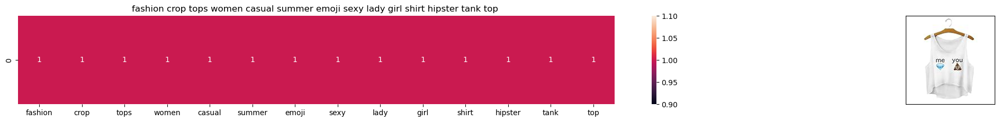

ASIN : B010V3B44G
Brand: Doxi Supermall
Title: fashion crop tops women casual summer emoji sexy lady girl shirt hipster tank top 
Euclidean similarity with the query image : 0.0


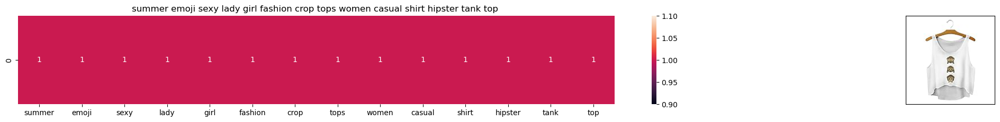

ASIN : B010V3BDII
Brand: Doxi Supermall
Title: summer emoji sexy lady girl fashion crop tops women casual shirt hipster tank top 
Euclidean similarity with the query image : 0.0


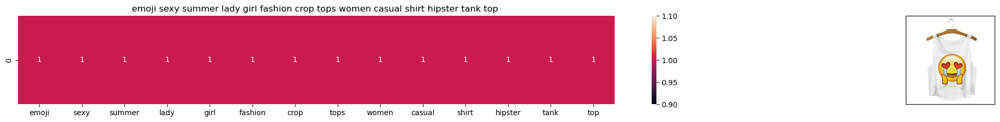

ASIN : B010V3BLWQ
Brand: Doxi Supermall
Title: emoji sexy summer lady girl fashion crop tops women casual shirt hipster tank top 
Euclidean similarity with the query image : 0.0


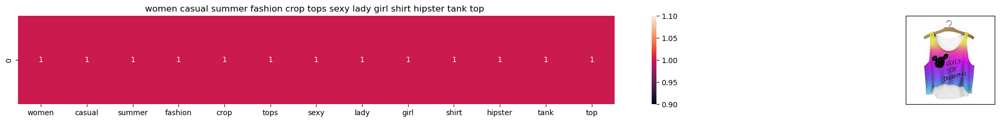

ASIN : B010V3AYSS
Brand: Doxi Supermall
Title: women casual summer fashion crop tops sexy lady girl shirt hipster tank top 
Euclidean similarity with the query image : 1.0


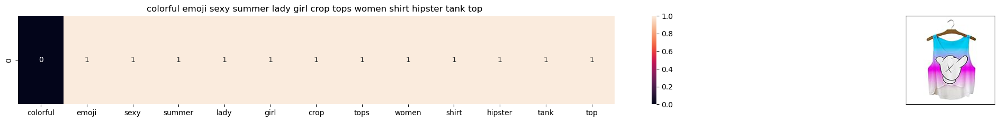

ASIN : B010V3BQZS
Brand: Doxi Supermall
Title: colorful emoji sexy summer lady girl crop tops women shirt hipster tank top 
Euclidean similarity with the query image : 1.7320508075688772


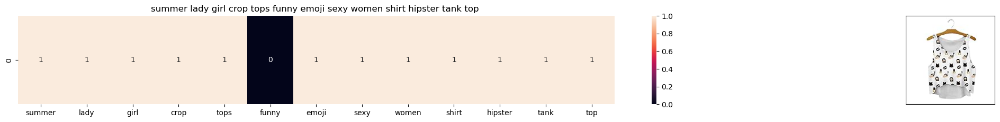

ASIN : B010V3BVMQ
Brand: Doxi Supermall
Title: summer lady girl crop tops funny emoji sexy women shirt hipster tank top 
Euclidean similarity with the query image : 1.7320508075688772


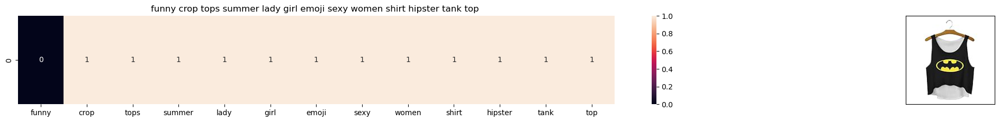

ASIN : B010V3C116
Brand: Doxi Supermall
Title: funny crop tops summer lady girl emoji sexy women shirt hipster tank top 
Euclidean similarity with the query image : 1.7320508075688772


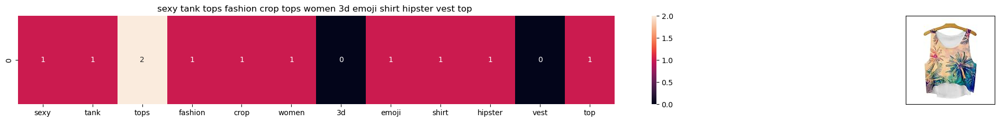

ASIN : B010V3DB9C
Brand: Doxi Supermall
Title: sexy tank tops fashion crop tops women 3d emoji shirt hipster vest top 
Euclidean similarity with the query image : 2.6457513110645907


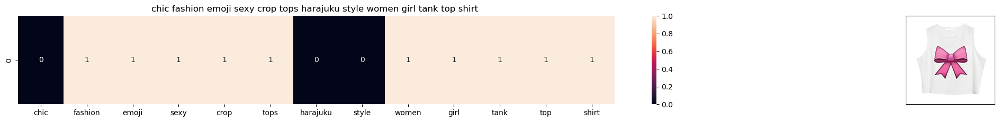

ASIN : B011RCJPR8
Brand: Chiclook Cool
Title: chic fashion emoji sexy crop tops harajuku style women girl tank top shirt 
Euclidean similarity with the query image : 2.6457513110645907


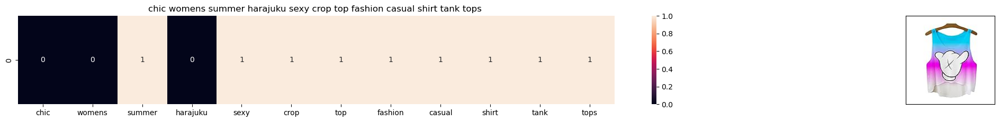

ASIN : B011RCJEMO
Brand: Chiclook Cool
Title: chic womens summer harajuku sexy crop top fashion casual shirt tank tops 
Euclidean similarity with the query image : 2.8284271247461903


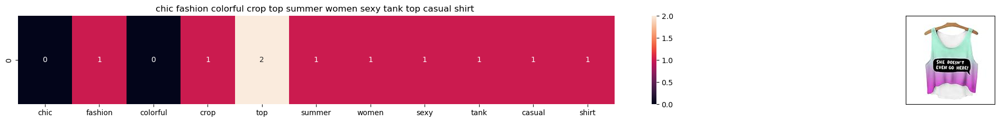

ASIN : B011RCJ6UE
Brand: Chiclook Cool
Title: chic fashion colorful crop top summer women sexy tank top casual shirt 
Euclidean similarity with the query image : 2.8284271247461903


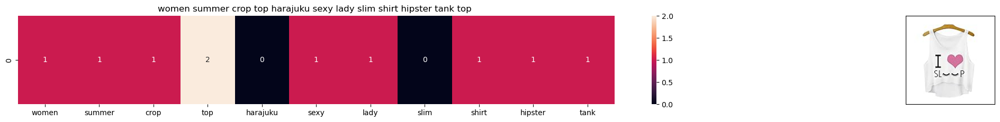

ASIN : B010V3EDEE
Brand: Doxi Supermall
Title: women summer crop top harajuku sexy lady slim shirt hipster tank top 
Euclidean similarity with the query image : 2.8284271247461903


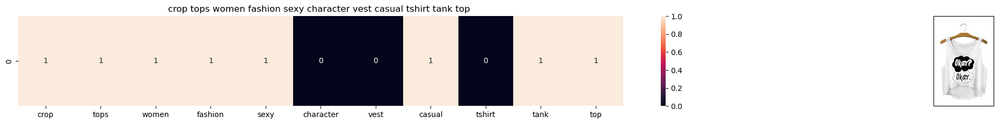

ASIN : B0107UEPVM
Brand: Mang GO
Title: crop tops women fashion sexy character vest casual tshirt tank top 
Euclidean similarity with the query image : 3.0


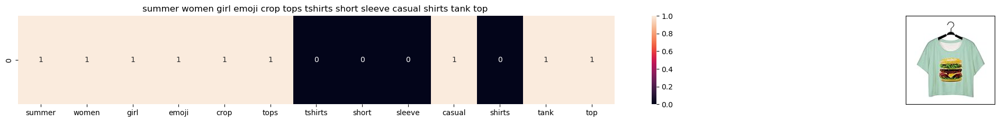

ASIN : B0124ECIU4
Brand: Doxi Supermall
Title: summer women girl emoji crop tops tshirts short sleeve casual shirts tank top 
Euclidean similarity with the query image : 3.0


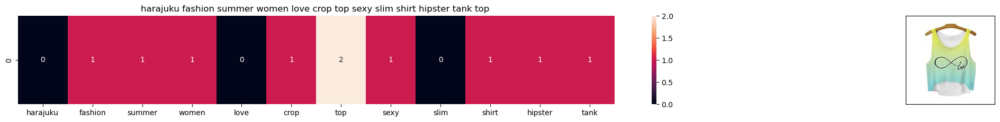

ASIN : B010V35OBU
Brand: Doxi Supermall
Title: harajuku fashion summer women love crop top sexy slim shirt hipster tank top 
Euclidean similarity with the query image : 3.0


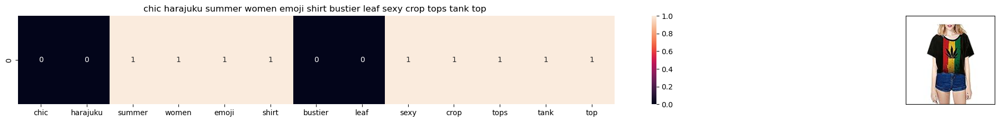

ASIN : B011UEXGH8
Brand: Chiclook Cool
Title: chic harajuku summer women emoji shirt bustier leaf sexy crop tops tank top 
Euclidean similarity with the query image : 3.0


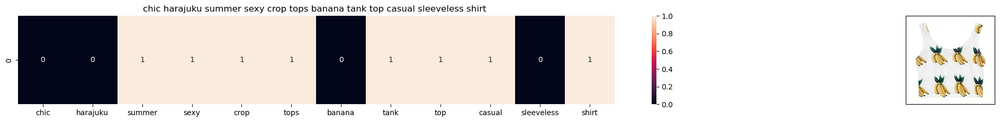

ASIN : B011RCIQBE
Brand: Chiclook Cool
Title: chic harajuku summer sexy crop tops banana tank top casual sleeveless shirt 
Euclidean similarity with the query image : 3.1622776601683795


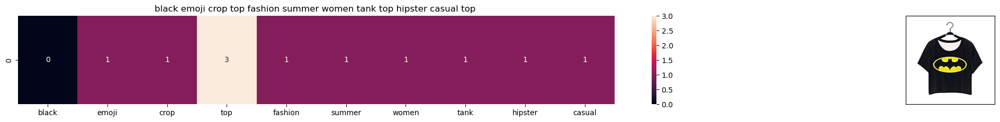

ASIN : B0124E80M4
Brand: Doxi Supermall
Title: black emoji crop top fashion summer women tank top hipster casual top 
Euclidean similarity with the query image : 3.1622776601683795


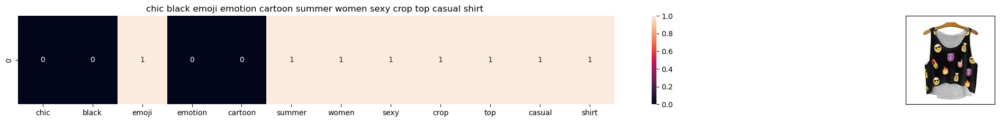

ASIN : B011RCJ4M4
Brand: Chiclook Cool
Title: chic black emoji emotion cartoon summer women sexy crop top casual shirt 
Euclidean similarity with the query image : 3.1622776601683795


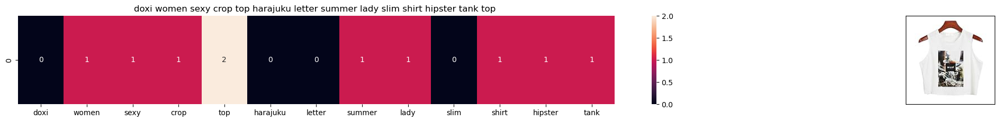

ASIN : B010V39146
Brand: Doxi Supermall
Title: doxi women sexy crop top harajuku letter summer lady slim shirt hipster tank top 
Euclidean similarity with the query image : 3.1622776601683795


In [146]:
def bag_of_words_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(title_features,title_features[doc_id])
    
    # np.argsort will return indices of the smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    
    for i in range(0,len(indices)):
        # we will pass 1. doc_id, 2. title1, 3. title2, url, model
        get_result(indices[i],data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'bag_of_words')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print ('Brand:', data['brand'].loc[df_indices[i]])
        print ('Title:', data['title'].loc[df_indices[i]])
        print ('Euclidean similarity with the query image :', pdists[i])
        print('='*60)

#call the bag-of-words model for a product to get similar products.
bag_of_words_model(12566, 20) # change the index if you want to.
# In the output heat map each value represents the count value 
# of the label word, the color represents the intersection 
# with inputs title.

#try 12566
#try 931


If two titles have most words similar occuring then distance is less

* fashion crop tops women casual summer emoji sexy lady girl shirt hipster tank top 

* summer emoji sexy lady girl fashion crop tops women casual shirt hipster tank top 

Need to deduplication effectively because preprocessing doesn't work very well

***

> <div class="alert alert-block alert-success">
<b>Bag of words does not work that well</b> 
</div> 


***

## Tfidf Model



> **TF** :

* For corpus D, each document T1, T2, T3 .... and for words w1, w2, w3 ...
    - TF(wj, Ti) - Term Frequency of wj in document Ti **(How many times word occur in this title/ No of words in Ti)**
    
> <div class="alert alert-block alert-danger">
<b>Term Frequency is high when word occurs more in the document</b> 
</div>     
 



> **IDF** :
* For each word w1, w2, w3 ...
    - IDF(wj) Inverse document Frequency - ** Calculated on whole document for given word**
 
    - log(# of documents in D / # of docs in D that contains wj) 
***
* Very Frequent Word
ex. IDF(tshirt) = log(16k&nbsp;/&nbsp; 12k) = 0.124 

**More Frequent Words have low IDF**
***
* Rare Word
ex. IDF(Tiger) = log(16k&nbsp;/&nbsp;200) = 2.20 

**Rare Words have High IDF**
***

> <div class="alert alert-block alert-danger">
<b>IDF measures how rare word is</b> 
</div> 



Ti -> w1, w2, w3, w4
- w1 -> TF(w1, Ti) * IDF(w1)        
- w2 -> TF(w2, Ti) * IDF(w2)
- w3 -> TF(w3, Ti) * IDF(w3)
- w4 -> TF(w4, Ti) * IDF(w4)

-------------- All such values are used in word vector instead of frequency as in BOW -----------------
TFIDF()

Using TFIDF instead of BOW

In [104]:
tfidf_title_vectorizer = TfidfVectorizer(min_df = 0.0)
tfidf_title_features = tfidf_title_vectorizer.fit_transform(data['title'])
# tfidf_title_features.shape = #data_points * #words_in_corpus
# CountVectorizer().fit_transform(courpus) returns the a sparase matrix of dimensions #data_points * #words_in_corpus
# tfidf_title_features[doc_id, index_of_word_in_corpus] = tfidf values of the word in given doc

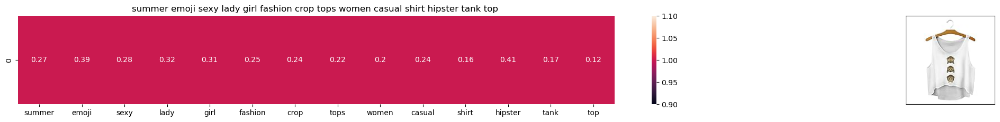

ASIN : B010V3BDII
BRAND : Doxi Supermall
Title: summer emoji sexy lady girl fashion crop tops women casual shirt hipster tank top 
Eucliden distance from the given image : 0.0


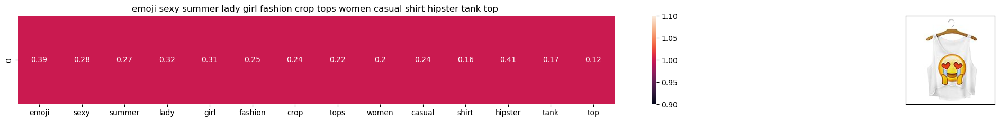

ASIN : B010V3BLWQ
BRAND : Doxi Supermall
Title: emoji sexy summer lady girl fashion crop tops women casual shirt hipster tank top 
Eucliden distance from the given image : 0.0


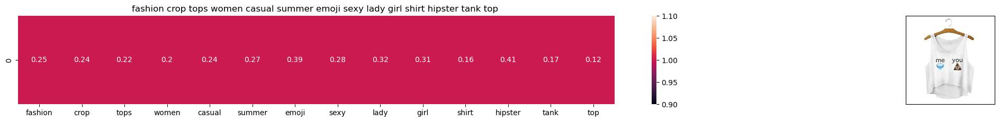

ASIN : B010V3B44G
BRAND : Doxi Supermall
Title: fashion crop tops women casual summer emoji sexy lady girl shirt hipster tank top 
Eucliden distance from the given image : 0.0


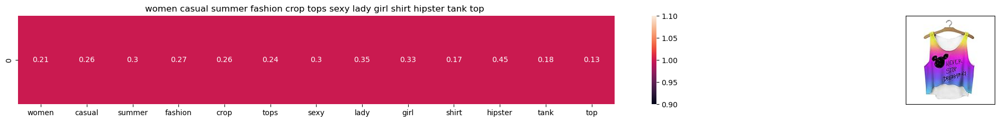

ASIN : B010V3AYSS
BRAND : Doxi Supermall
Title: women casual summer fashion crop tops sexy lady girl shirt hipster tank top 
Eucliden distance from the given image : 0.40138594750235


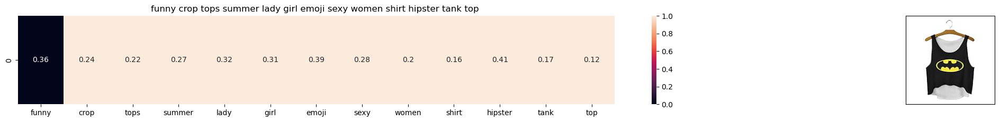

ASIN : B010V3C116
BRAND : Doxi Supermall
Title: funny crop tops summer lady girl emoji sexy women shirt hipster tank top 
Eucliden distance from the given image : 0.49544215538955555


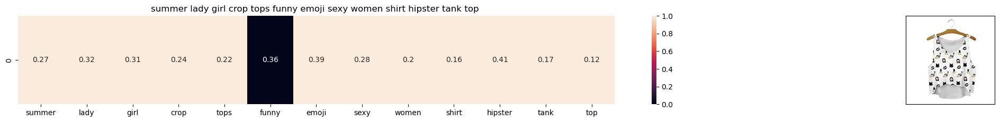

ASIN : B010V3BVMQ
BRAND : Doxi Supermall
Title: summer lady girl crop tops funny emoji sexy women shirt hipster tank top 
Eucliden distance from the given image : 0.49544215538955555


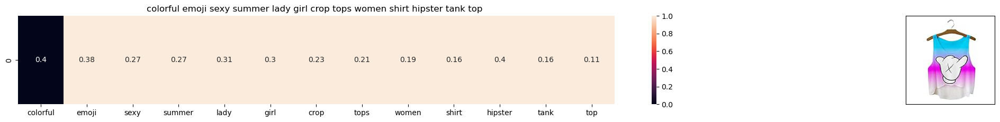

ASIN : B010V3BQZS
BRAND : Doxi Supermall
Title: colorful emoji sexy summer lady girl crop tops women shirt hipster tank top 
Eucliden distance from the given image : 0.5241689140292634


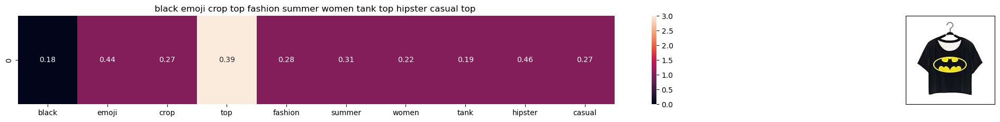

ASIN : B0124E80M4
BRAND : Doxi Supermall
Title: black emoji crop top fashion summer women tank top hipster casual top 
Eucliden distance from the given image : 0.684158162664275


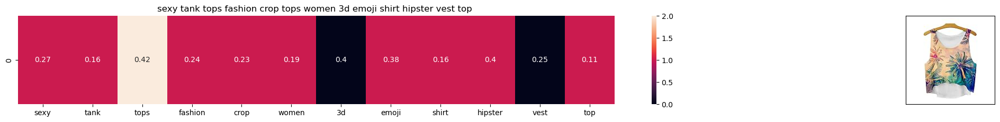

ASIN : B010V3DB9C
BRAND : Doxi Supermall
Title: sexy tank tops fashion crop tops women 3d emoji shirt hipster vest top 
Eucliden distance from the given image : 0.7731343455110792


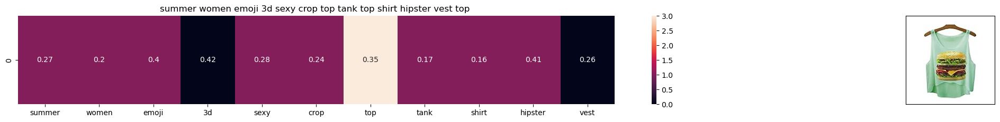

ASIN : B010V3E5EC
BRAND : Doxi Supermall
Title: summer women emoji 3d sexy crop top tank top shirt hipster vest top 
Eucliden distance from the given image : 0.8128754313990525


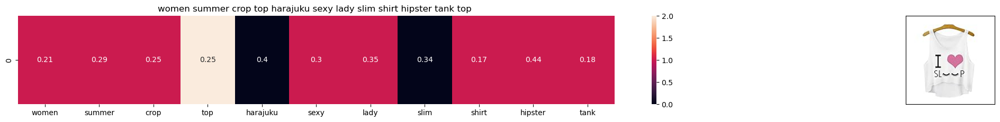

ASIN : B010V3EDEE
BRAND : Doxi Supermall
Title: women summer crop top harajuku sexy lady slim shirt hipster tank top 
Eucliden distance from the given image : 0.8437056912864757


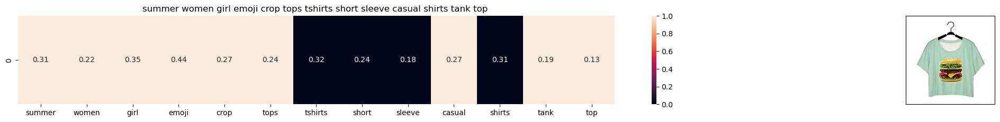

ASIN : B0124ECIU4
BRAND : Doxi Supermall
Title: summer women girl emoji crop tops tshirts short sleeve casual shirts tank top 
Eucliden distance from the given image : 0.8553483954246192


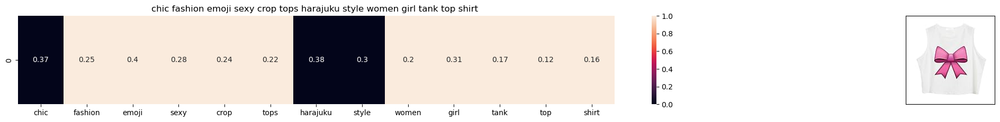

ASIN : B011RCJPR8
BRAND : Chiclook Cool
Title: chic fashion emoji sexy crop tops harajuku style women girl tank top shirt 
Eucliden distance from the given image : 0.8826321316686153


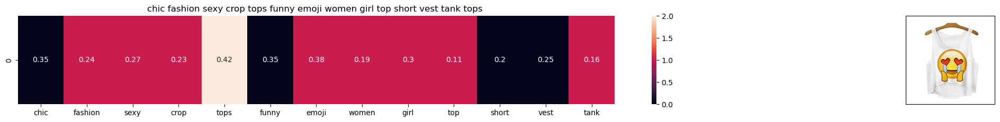

ASIN : B011RCJH58
BRAND : Chiclook Cool
Title: chic fashion sexy crop tops funny emoji women girl top short vest tank tops 
Eucliden distance from the given image : 0.9004017468013861


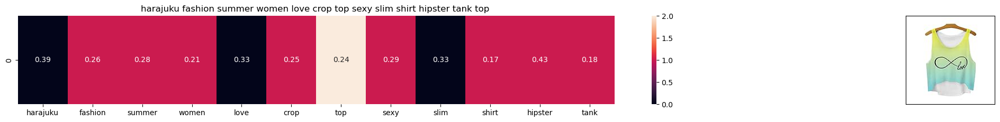

ASIN : B010V35OBU
BRAND : Doxi Supermall
Title: harajuku fashion summer women love crop top sexy slim shirt hipster tank top 
Eucliden distance from the given image : 0.9172816572673457


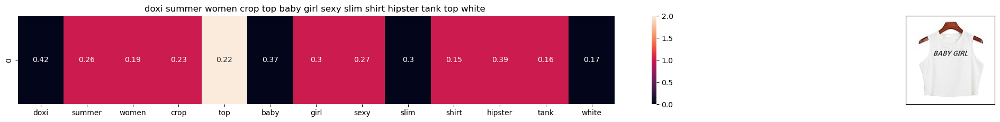

ASIN : B010V3A23U
BRAND : Doxi Supermall
Title: doxi summer women crop top baby girl sexy slim shirt hipster tank top white 
Eucliden distance from the given image : 0.9303848929561548


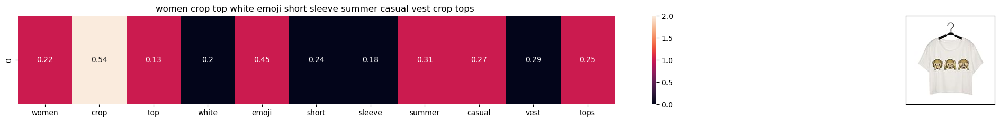

ASIN : B0124E7MHS
BRAND : Doxi Supermall
Title: women crop top white emoji short sleeve summer casual vest crop tops 
Eucliden distance from the given image : 0.9334421080980745


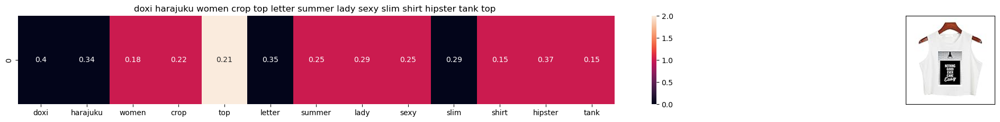

ASIN : B010V380LQ
BRAND : Doxi Supermall
Title: doxi harajuku women crop top letter summer lady sexy slim shirt hipster tank top 
Eucliden distance from the given image : 0.9525344637195033


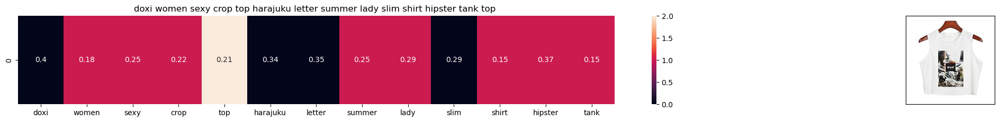

ASIN : B010V39146
BRAND : Doxi Supermall
Title: doxi women sexy crop top harajuku letter summer lady slim shirt hipster tank top 
Eucliden distance from the given image : 0.9525344637195033


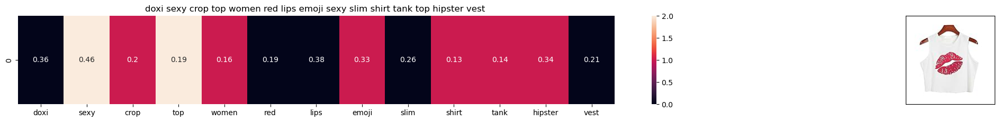

ASIN : B010TKXEHG
BRAND : Doxi Supermall
Title: doxi sexy crop top women red lips emoji sexy slim shirt tank top hipster vest 
Eucliden distance from the given image : 0.9560708174154957


In [147]:
def tfidf_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(tfidf_title_features,tfidf_title_features[doc_id])

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])

    for i in range(0,len(indices)):
        # we will pass 1. doc_id, 2. title1, 3. title2, url, model
        get_result(indices[i], data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'tfidf')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('BRAND :',data['brand'].loc[df_indices[i]])
        print ('Title:', data['title'].loc[df_indices[i]])
        print ('Eucliden distance from the given image :', pdists[i])
        print('='*125)
tfidf_model(12566, 20)
# in the output heat map each value represents the tfidf values of the label word, the color represents the intersection with inputs title

**Problem with TFIDF: (Most words do not repeat in a sentence)**
    - T1 = w1, w2, w3, w4, w5 ... w10 ------TF(wi, T1) = 1/10
    - T2 = w1, w2, w3, w4             ------TF(wi, T2) = 1/4
- Shorter sentences will have high TF values for words in it
- TFIDF prefers shorter titles when I want to get similar items
    

> Completely drop TF, only use IDF vectorizer

## IDF Model

In [121]:
idf_title_vectorizer = CountVectorizer()
idf_title_features = idf_title_vectorizer.fit_transform(data['title'])

# idf_title_features.shape = #data_points * #words_in_corpus
# CountVectorizer().fit_transform(courpus) returns the a sparase matrix of dimensions #data_points * #words_in_corpus
# idf_title_features[doc_id, index_of_word_in_corpus] = number of times the word occured in that doc


In [123]:
###Calculate IDF values for the word

def n_containing(word):
    # return the number of documents which had the given word
    return sum(1 for blob in data['title'] if word in blob.split())

def idf(word):
    # idf = log(#number of docs / #number of docs which had the given word)
    return math.log(data.shape[0] / (n_containing(word)))

In [125]:
# we need to convert the values into float
idf_title_features  = idf_title_features.astype(float)

for i in idf_title_vectorizer.vocabulary_.keys():
    # for every word in whole corpus we will find its idf value
    idf_val = idf(i)
    
    # to calculate idf_title_features we need to replace the count values with the idf values of the word
    # idf_title_features[:, idf_title_vectorizer.vocabulary_[i]].nonzero()[0] will return all documents in which the word i present
    for j in idf_title_features[:, idf_title_vectorizer.vocabulary_[i]].nonzero()[0]:
        
        # we replace the count values of word i in document j with  idf_value of word i 
        # idf_title_features[doc_id, index_of_word_in_courpus] = idf value of word
        idf_title_features[j,idf_title_vectorizer.vocabulary_[i]] = idf_val
        

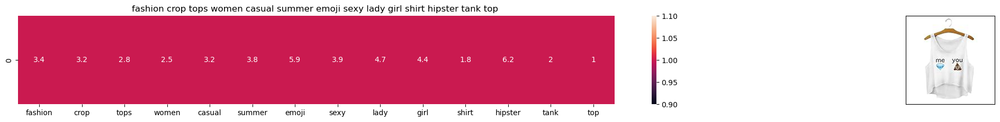

ASIN : B010V3B44G
Brand : Doxi Supermall
euclidean distance from the given image : 0.0


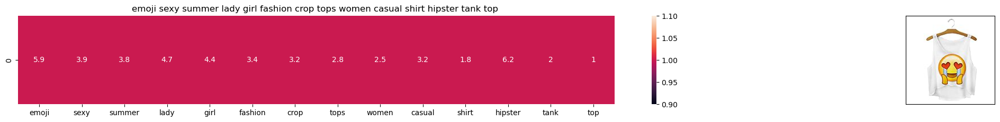

ASIN : B010V3BLWQ
Brand : Doxi Supermall
euclidean distance from the given image : 0.0


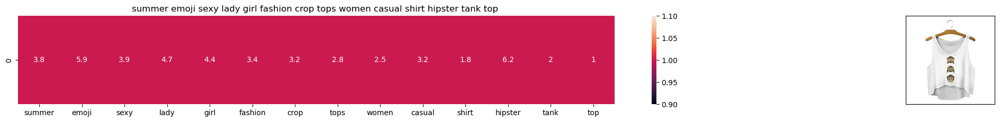

ASIN : B010V3BDII
Brand : Doxi Supermall
euclidean distance from the given image : 0.0


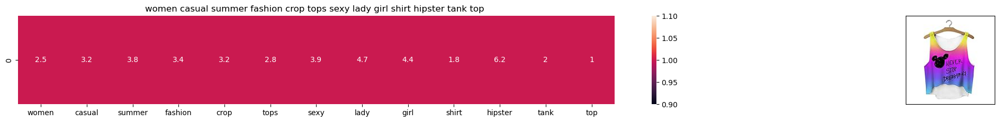

ASIN : B010V3AYSS
Brand : Doxi Supermall
euclidean distance from the given image : 5.922978852180059


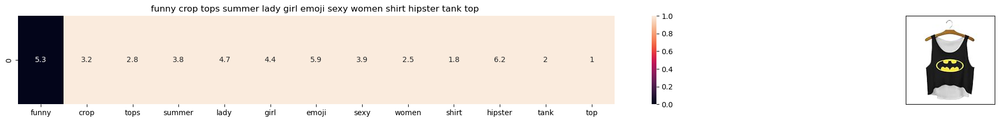

ASIN : B010V3C116
Brand : Doxi Supermall
euclidean distance from the given image : 7.037272185298332


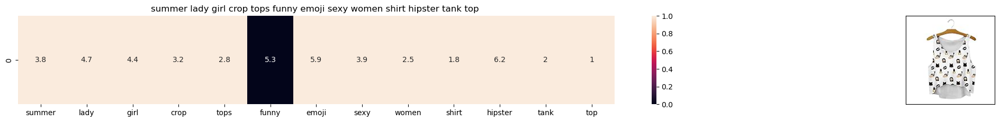

ASIN : B010V3BVMQ
Brand : Doxi Supermall
euclidean distance from the given image : 7.037272185298332


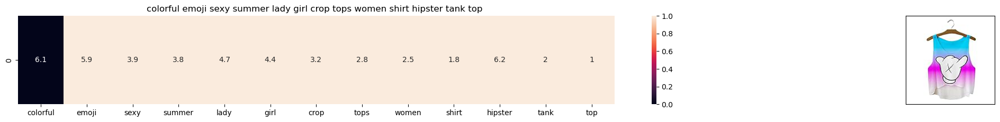

ASIN : B010V3BQZS
Brand : Doxi Supermall
euclidean distance from the given image : 7.667939547088641


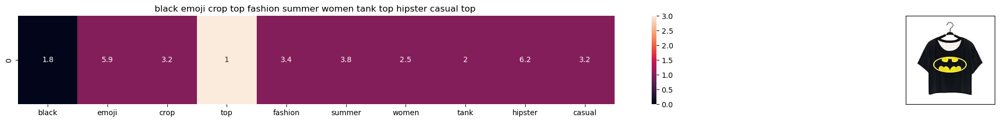

ASIN : B0124E80M4
Brand : Doxi Supermall
euclidean distance from the given image : 8.39863603811248


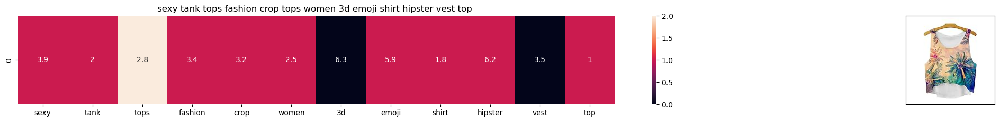

ASIN : B010V3DB9C
Brand : Doxi Supermall
euclidean distance from the given image : 10.835090137343855


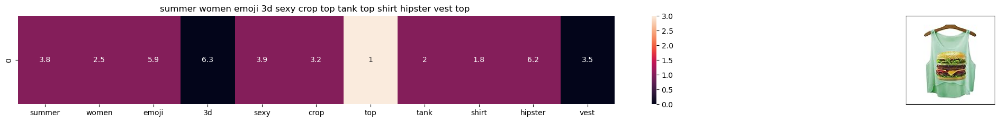

ASIN : B010V3E5EC
Brand : Doxi Supermall
euclidean distance from the given image : 11.060530175472811


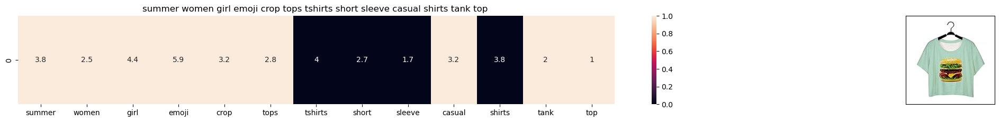

ASIN : B0124ECIU4
Brand : Doxi Supermall
euclidean distance from the given image : 11.456017724459604


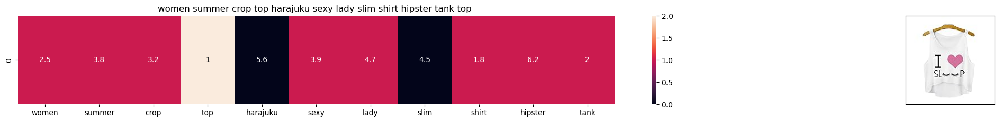

ASIN : B010V3EDEE
Brand : Doxi Supermall
euclidean distance from the given image : 11.635265990125815


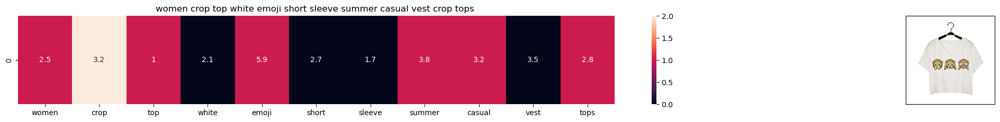

ASIN : B0124E7MHS
Brand : Doxi Supermall
euclidean distance from the given image : 11.844834283822053


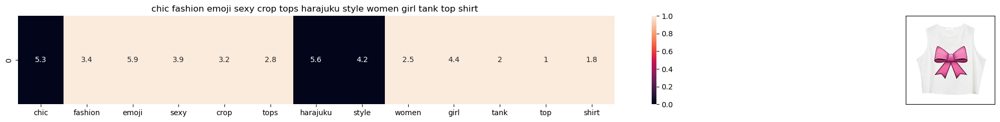

ASIN : B011RCJPR8
Brand : Chiclook Cool
euclidean distance from the given image : 12.760692810178545


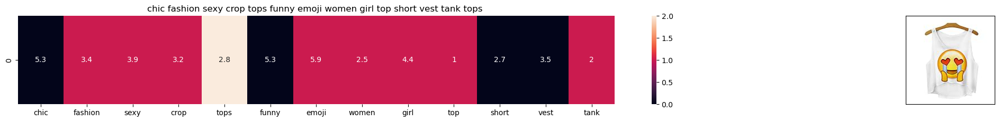

ASIN : B011RCJH58
Brand : Chiclook Cool
euclidean distance from the given image : 12.829128504563066


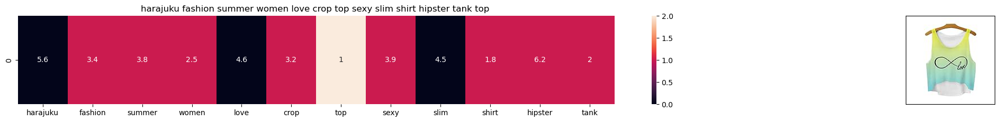

ASIN : B010V35OBU
Brand : Doxi Supermall
euclidean distance from the given image : 12.92180694297083


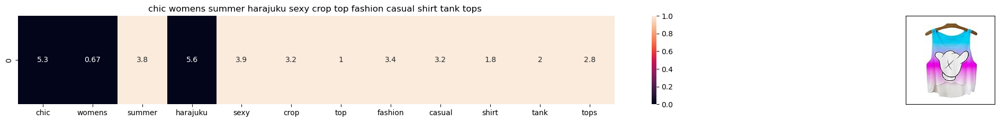

ASIN : B011RCJEMO
Brand : Chiclook Cool
euclidean distance from the given image : 13.474555736106787


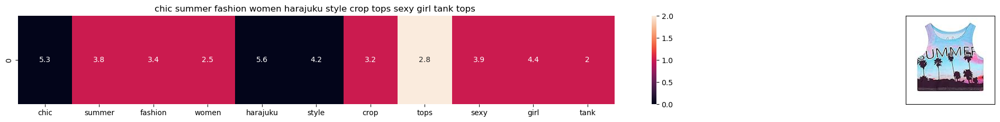

ASIN : B011OU51US
Brand : Chiclook Cool
euclidean distance from the given image : 13.713807644827545


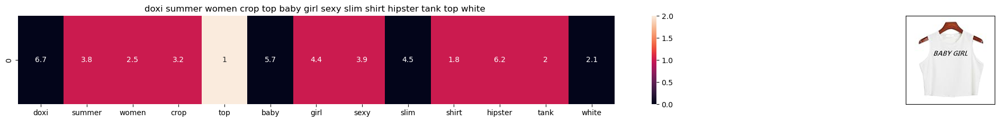

ASIN : B010V3A23U
Brand : Doxi Supermall
euclidean distance from the given image : 13.725325741546714


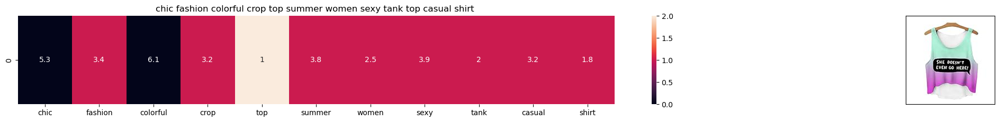

ASIN : B011RCJ6UE
Brand : Chiclook Cool
euclidean distance from the given image : 13.746787336587824


In [148]:
def idf_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(idf_title_features,idf_title_features[doc_id])

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])

    for i in range(0,len(indices)):
        get_result(indices[i],data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'idf')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print ('euclidean distance from the given image :', pdists[i])
        print('='*125)

        
        
idf_model(12566,20)
# in the output heat map each value represents the idf values of the label word, the color represents the intersection with inputs title

> <div class="alert alert-block alert-danger">
<b>IDF Model does not give good result</b> 
</div>  

## Semantic Similarity Model

TFIDF, BOW do not account for semantics at all -> Both are frequency counter

### Word2Vec  --> Dense Vector Word Representation

Words occuring in similar context have similar vectors

GoogleNews trained Word2vec ------> For Title Repr: add all word vectors

**Average Word2Vec Model**

In [129]:
##How to train our own word2vec model -- Needs huge corpus
## Thus did not used
# num_features = 300
# min_word_count = 1
# num_workers = 4
# context = 10
# downsampling = 1e-3

# from gensim.models import word2vec
# print('Training Model')
# model = word2vec.Word2Vec(sen_corpus, workers=num_workers, 
#                          size=num_features, min_count=min_word_count,
#                          window=context)


In [131]:
# in this project we are using a pretrained model by google
# its 3.3G file, once you load this into your memory 
# it occupies ~9Gb, so please do this step only if you have >12G of ram
# we will provide a pickle file wich contains a dict , 
# and it contains all our courpus words as keys and  model[word] as values
# To use this code-snippet, download "GoogleNews-vectors-negative300.bin" 
# from https://drive.google.com/file/d/0B7XkCwpI5KDYNlNUTTlSS21pQmM/edit
# it's 1.9GB in size.

'''
model = KeyedVectors.load_word2vec_format('GoogleNews-vectors-negative300.bin', binary=True)
'''

"\nmodel = KeyedVectors.load_word2vec_format('GoogleNews-vectors-negative300.bin', binary=True)\n"

Use Pretrained Word Vectors  -- Already Provided

In [132]:
from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

with open('word2vec_model', 'rb') as handle:
    model = pickle.load(handle)

### Utility functions


In [133]:

def get_word_vec(sentence, doc_id, m_name):
    # sentence : title of the apparel
    # doc_id: document id in our corpus
    # m_name: model information it will take two values
        # if  m_name == 'avg', we will append the model[i], w2v representation of word i
        # if m_name == 'weighted', we will multiply each w2v[word] with the idf(word)
    vec = []
    for i in sentence.split():
        if i in vocab:
            if m_name == 'weighted' and i in  idf_title_vectorizer.vocabulary_:
                vec.append(idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[i]] * model[i])
            elif m_name == 'avg':
                vec.append(model[i])
        else:
            # if the word in our courpus is not there in the google word2vec corpus, we are just ignoring it
            vec.append(np.zeros(shape=(300,)))
    # we will return a numpy array of shape (#number of words in title * 300 ) 300 = len(w2v_model[word])
    # each row represents the word2vec representation of each word (weighted/avg) in given sentance 
    return  np.array(vec)

def get_distance(vec1, vec2):
    # vec1 = np.array(#number_of_words_title1 * 300), each row is a vector of length 300 corresponds to each word in give title
    # vec2 = np.array(#number_of_words_title2 * 300), each row is a vector of length 300 corresponds to each word in give title
    
    final_dist = []
    # for each vector in vec1 we caluclate the distance(euclidean) to all vectors in vec2
    for i in vec1:
        dist = []
        for j in vec2:
            # np.linalg.norm(i-j) will result the euclidean distance between vectors i, j
            dist.append(np.linalg.norm(i-j))
        final_dist.append(np.array(dist))
    # final_dist = np.array(#number of words in title1 * #number of words in title2)
    # final_dist[i,j] = euclidean distance between vectors i, j
    return np.array(final_dist)


def heat_map_w2v(sentence1, sentence2, url, doc_id1, doc_id2, model):
    # sentance1 : title1, input apparel
    # sentance2 : title2, recommended apparel
    # url: apparel image url
    # doc_id1: document id of input apparel
    # doc_id2: document id of recommended apparel
    # model: it can have two values, 1. avg 2. weighted
    
    #s1_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s1_vec = get_word_vec(sentence1, doc_id1, model)
    #s2_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s2_vec = get_word_vec(sentence2, doc_id2, model)

    # s1_s2_dist = np.array(#number of words in title1 * #number of words in title2)
    # s1_s2_dist[i,j] = euclidean distance between words i, j
    s1_s2_dist = get_distance(s1_vec, s2_vec)

    
    
    # devide whole figure into 2 parts 1st part displays heatmap 2nd part displays image of apparel
    gs = gridspec.GridSpec(2, 2, width_ratios=[4,1],height_ratios=[2,1]) 
    fig = plt.figure(figsize=(15,15))
    
    ax = plt.subplot(gs[0])
    # ploting the heap map based on the pairwise distances
    ax = sns.heatmap(np.round(s1_s2_dist,4), annot=True)
    # set the x axis labels as recommended apparels title
    ax.set_xticklabels(sentence2.split())
    # set the y axis labels as input apparels title
    ax.set_yticklabels(sentence1.split())
    # set title as recommended apparels title
    ax.set_title(sentence2)
    
    ax = plt.subplot(gs[1])
    # we remove all grids and axis labels for image
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])
    display_img(url, ax, fig)
    
    plt.show()

In [134]:
# vocab = stores all the words that are there in google w2v model
# vocab = model.wv.vocab.keys() # if you are using Google word2Vec

vocab = model.keys()
# this function will add the vectors of each word and returns the avg vector of given sentance
def build_avg_vec(sentence, num_features, doc_id, m_name):
    # sentace: its title of the apparel
    # num_features: the lenght of word2vec vector, its values = 300
    # m_name: model information it will take two values
        # if  m_name == 'avg', we will append the model[i], w2v representation of word i
        # if m_name == 'weighted', we will multiply each w2v[word] with the idf(word)

    featureVec = np.zeros((num_features,), dtype="float32")
    # we will intialize a vector of size 300 with all zeros
    # we add each word2vec(wordi) to this fetureVec
    nwords = 0
    
    for word in sentence.split():
        nwords += 1
        if word in vocab:
            if m_name == 'weighted' and word in  idf_title_vectorizer.vocabulary_:
                featureVec = np.add(featureVec, idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[word]] * model[word])
            elif m_name == 'avg':
                featureVec = np.add(featureVec, model[word])
    if(nwords>0):
        featureVec = np.divide(featureVec, nwords)
    # returns the avg vector of given sentance, its of shape (1, 300)
    return featureVec

In [135]:
doc_id = 0
w2v_title = []
# for every title we build a avg vector representation
for i in data['title']:
    w2v_title.append(build_avg_vec(i, 300, doc_id,'avg'))
    doc_id += 1

# w2v_title = np.array(# number of doc in courpus * 300), each row corresponds to a doc 
w2v_title = np.array(w2v_title)

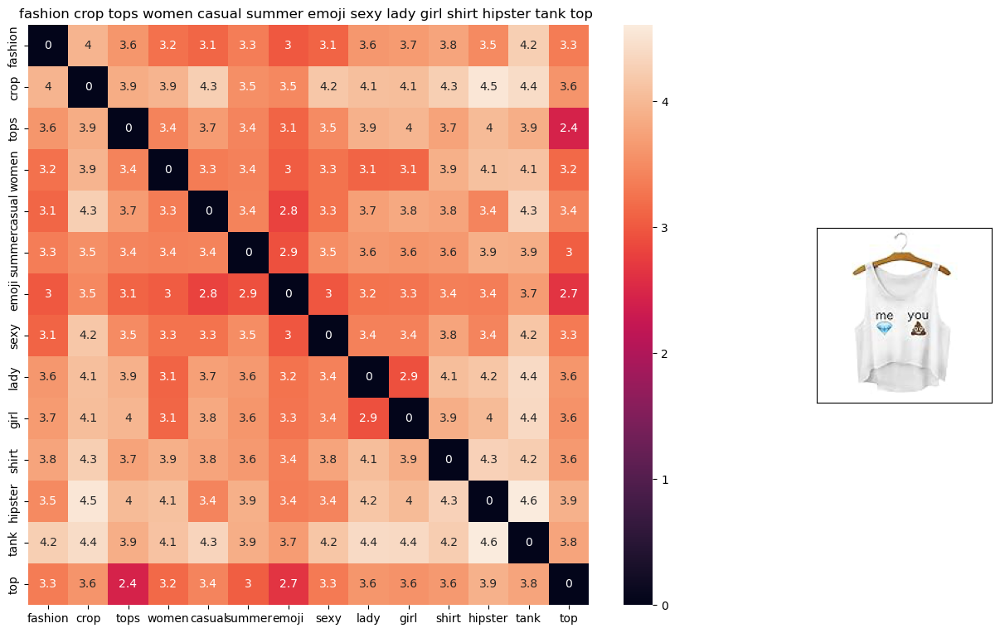

ASIN : B010V3B44G
BRAND : Doxi Supermall
Title: fashion crop tops women casual summer emoji sexy lady girl shirt hipster tank top 
euclidean distance from given input image : 2.9802322e-08


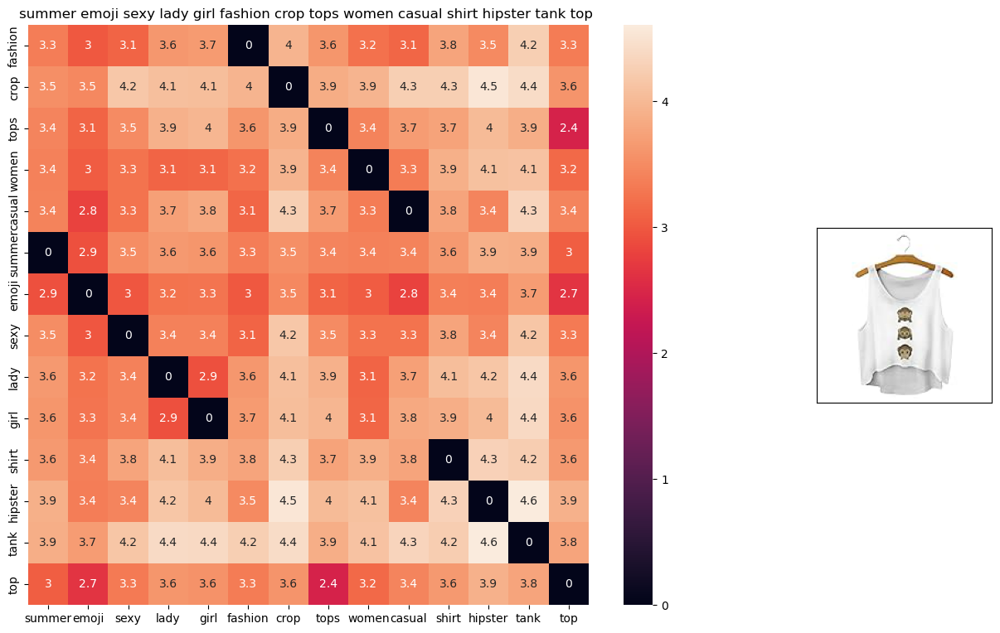

ASIN : B010V3BDII
BRAND : Doxi Supermall
Title: summer emoji sexy lady girl fashion crop tops women casual shirt hipster tank top 
euclidean distance from given input image : 2.9802322e-08


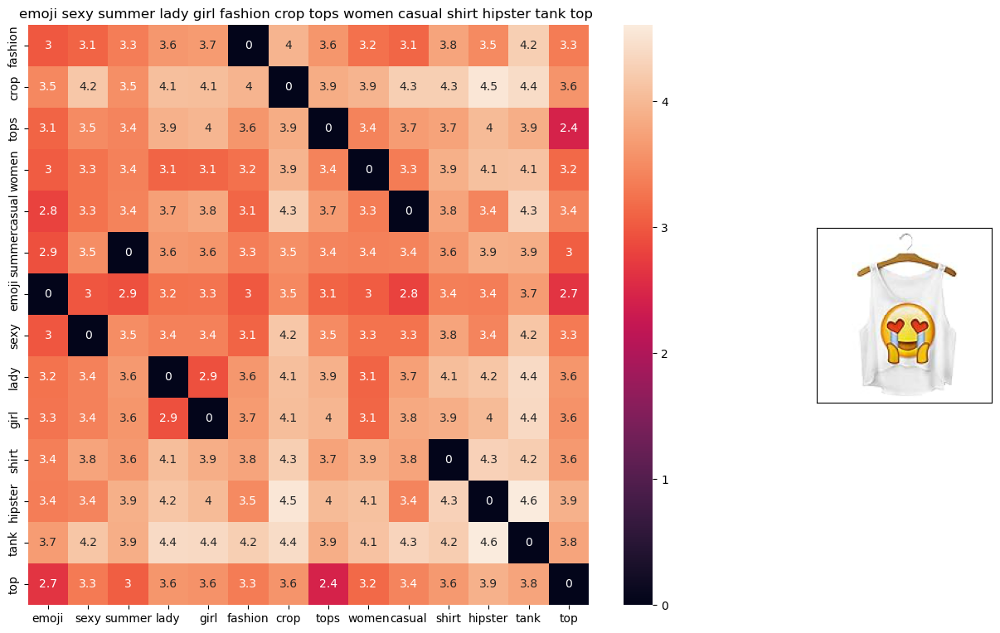

ASIN : B010V3BLWQ
BRAND : Doxi Supermall
Title: emoji sexy summer lady girl fashion crop tops women casual shirt hipster tank top 
euclidean distance from given input image : 2.9802322e-08


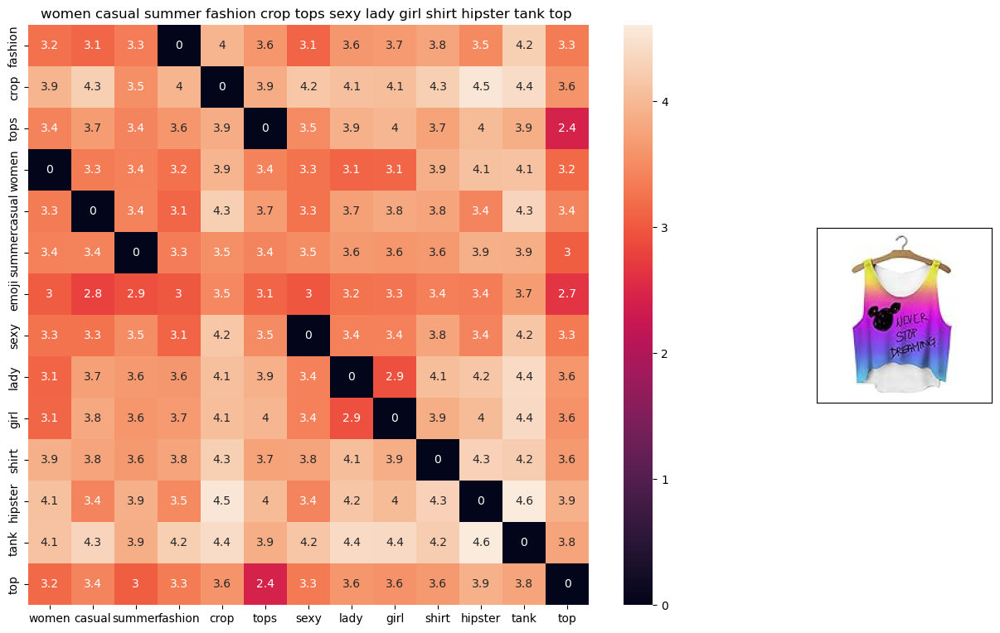

ASIN : B010V3AYSS
BRAND : Doxi Supermall
Title: women casual summer fashion crop tops sexy lady girl shirt hipster tank top 
euclidean distance from given input image : 0.13368244


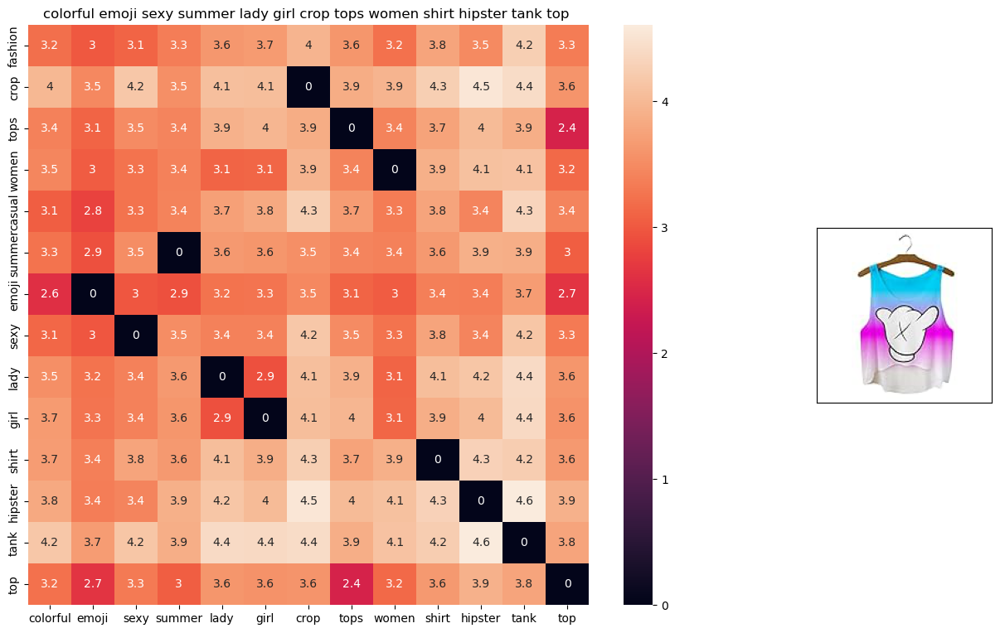

ASIN : B010V3BQZS
BRAND : Doxi Supermall
Title: colorful emoji sexy summer lady girl crop tops women shirt hipster tank top 
euclidean distance from given input image : 0.29837728


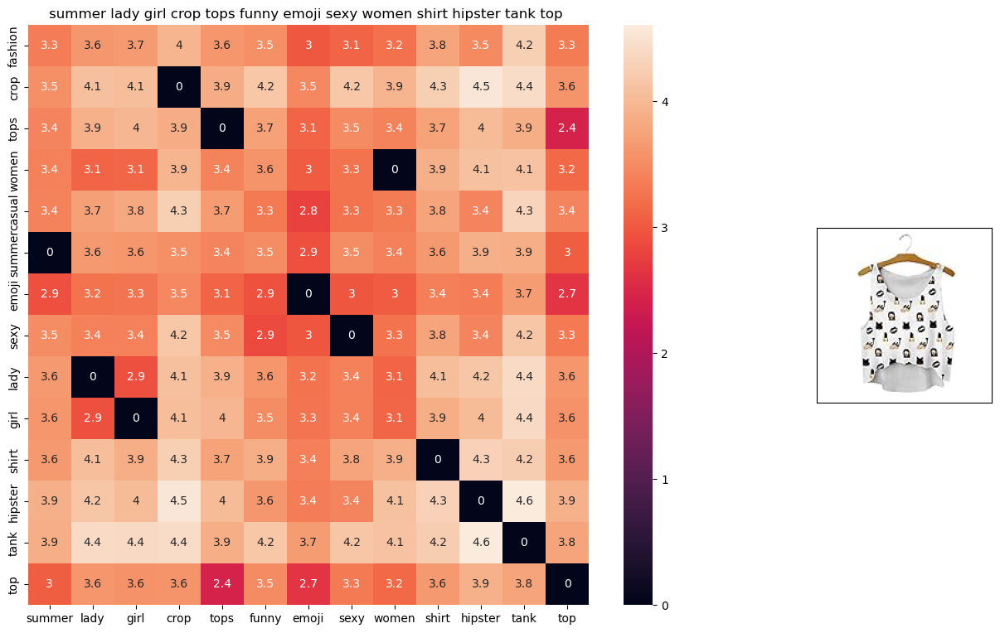

ASIN : B010V3BVMQ
BRAND : Doxi Supermall
Title: summer lady girl crop tops funny emoji sexy women shirt hipster tank top 
euclidean distance from given input image : 0.3274634


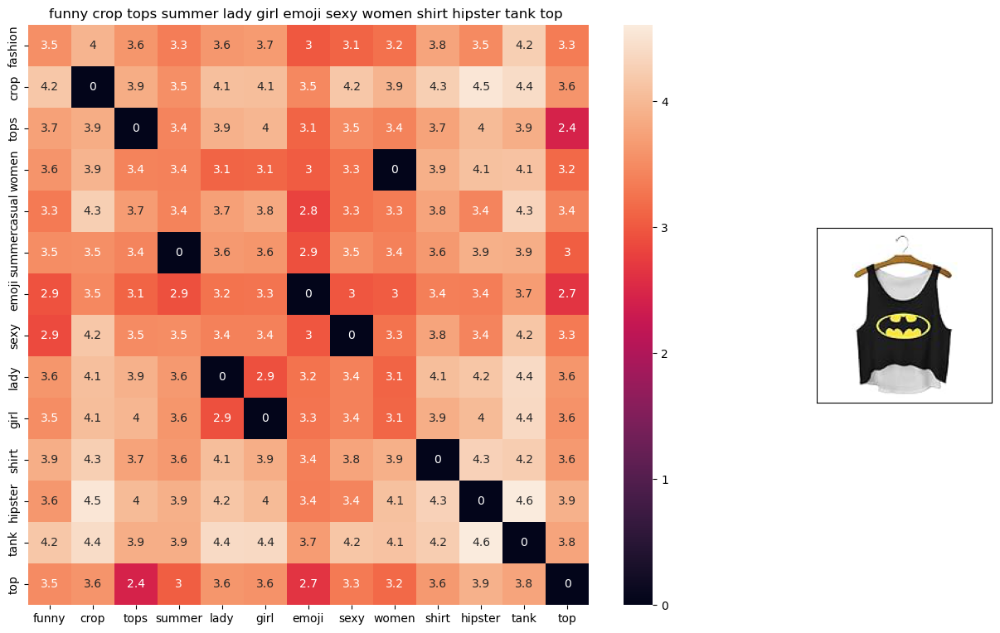

ASIN : B010V3C116
BRAND : Doxi Supermall
Title: funny crop tops summer lady girl emoji sexy women shirt hipster tank top 
euclidean distance from given input image : 0.3274634


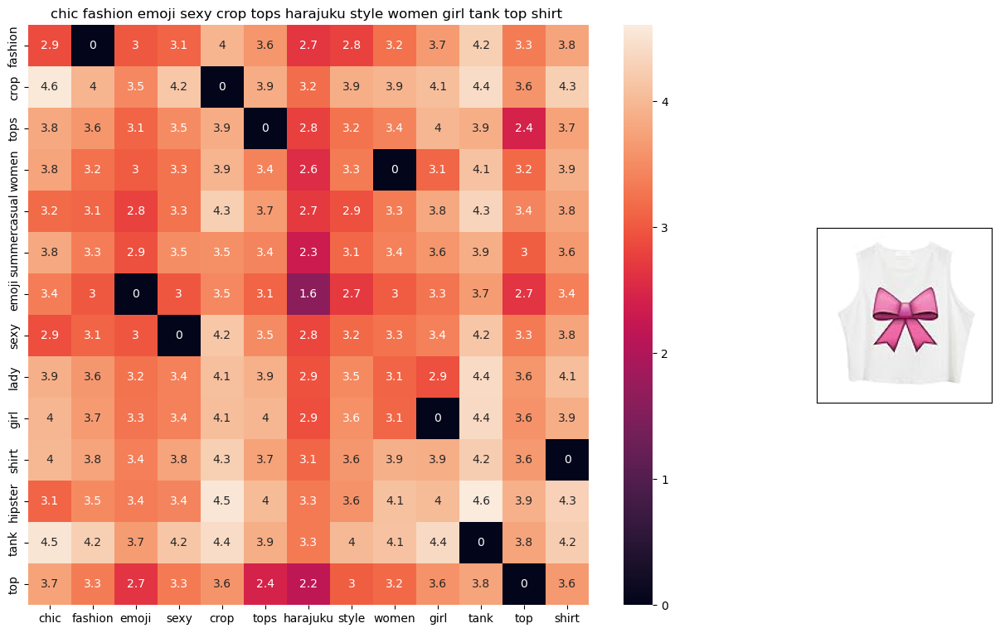

ASIN : B011RCJPR8
BRAND : Chiclook Cool
Title: chic fashion emoji sexy crop tops harajuku style women girl tank top shirt 
euclidean distance from given input image : 0.40975842


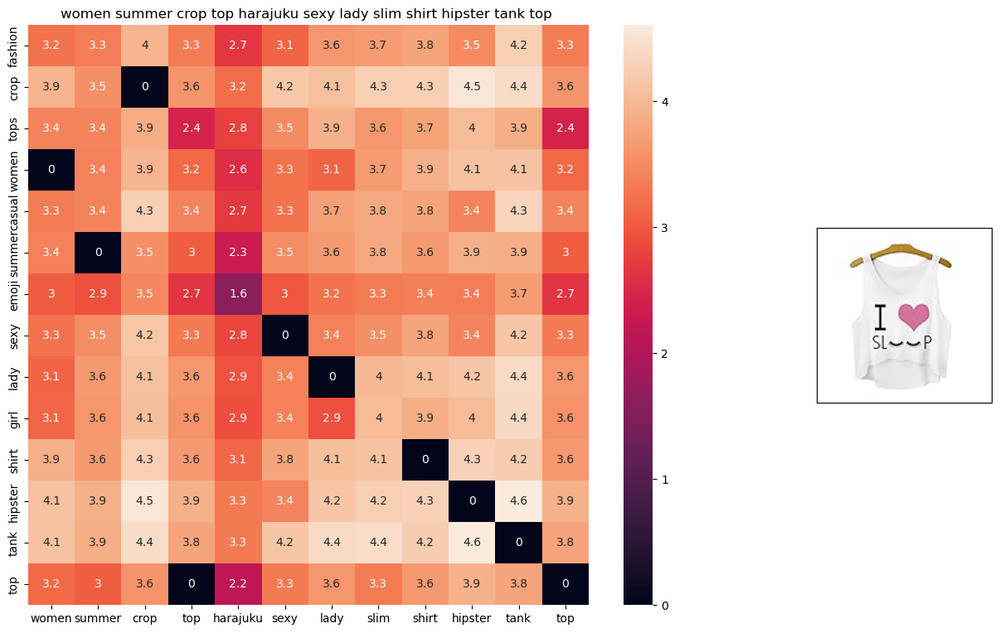

ASIN : B010V3EDEE
BRAND : Doxi Supermall
Title: women summer crop top harajuku sexy lady slim shirt hipster tank top 
euclidean distance from given input image : 0.46806592


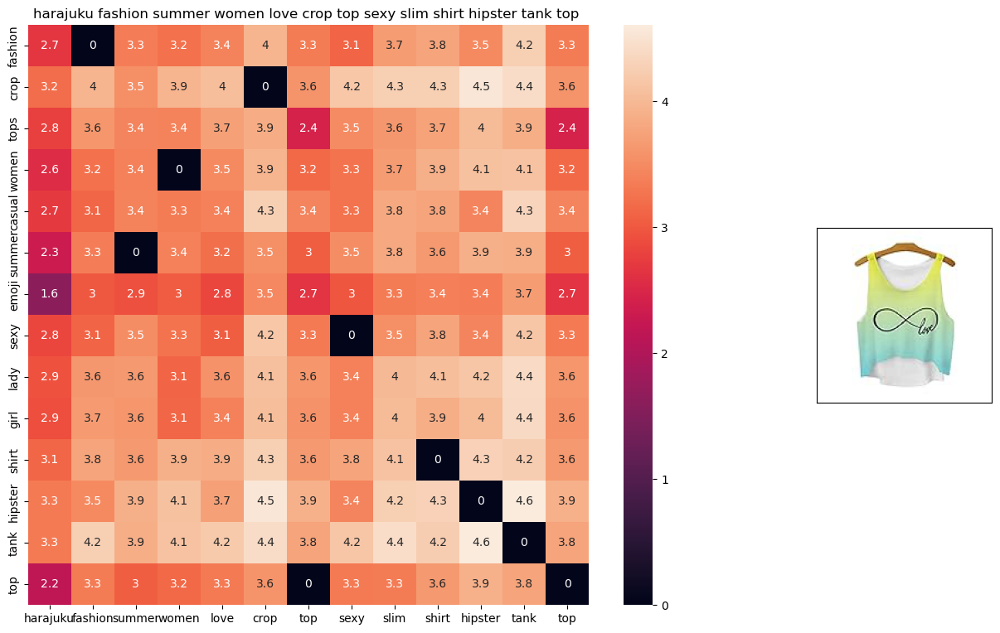

ASIN : B010V35OBU
BRAND : Doxi Supermall
Title: harajuku fashion summer women love crop top sexy slim shirt hipster tank top 
euclidean distance from given input image : 0.4957314


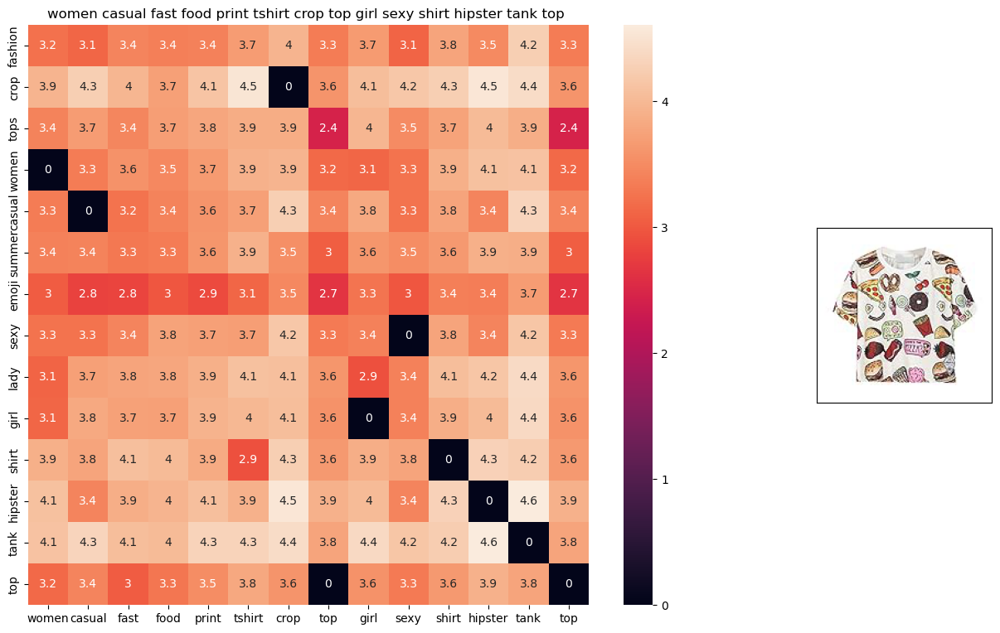

ASIN : B010V3AB5O
BRAND : Doxi Supermall
Title: women casual fast food print tshirt crop top girl sexy shirt hipster tank top 
euclidean distance from given input image : 0.50107545


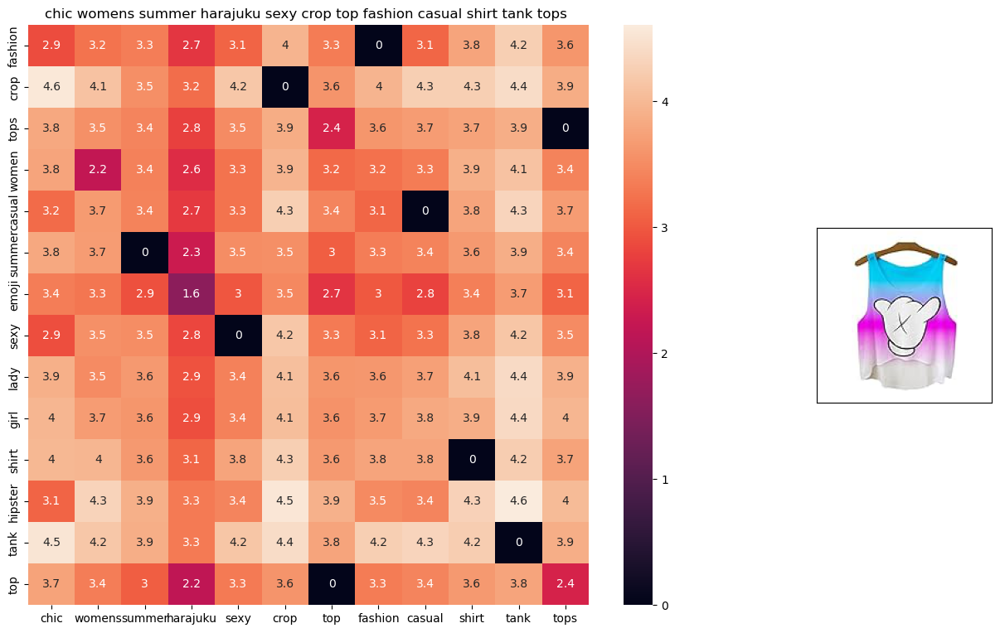

ASIN : B011RCJEMO
BRAND : Chiclook Cool
Title: chic womens summer harajuku sexy crop top fashion casual shirt tank tops 
euclidean distance from given input image : 0.5027281


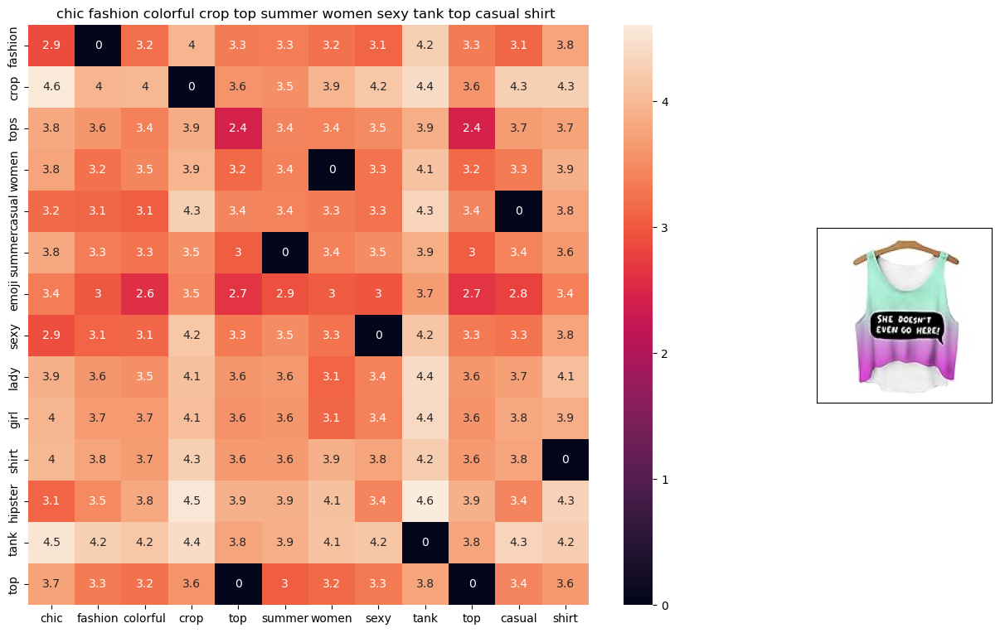

ASIN : B011RCJ6UE
BRAND : Chiclook Cool
Title: chic fashion colorful crop top summer women sexy tank top casual shirt 
euclidean distance from given input image : 0.5073639


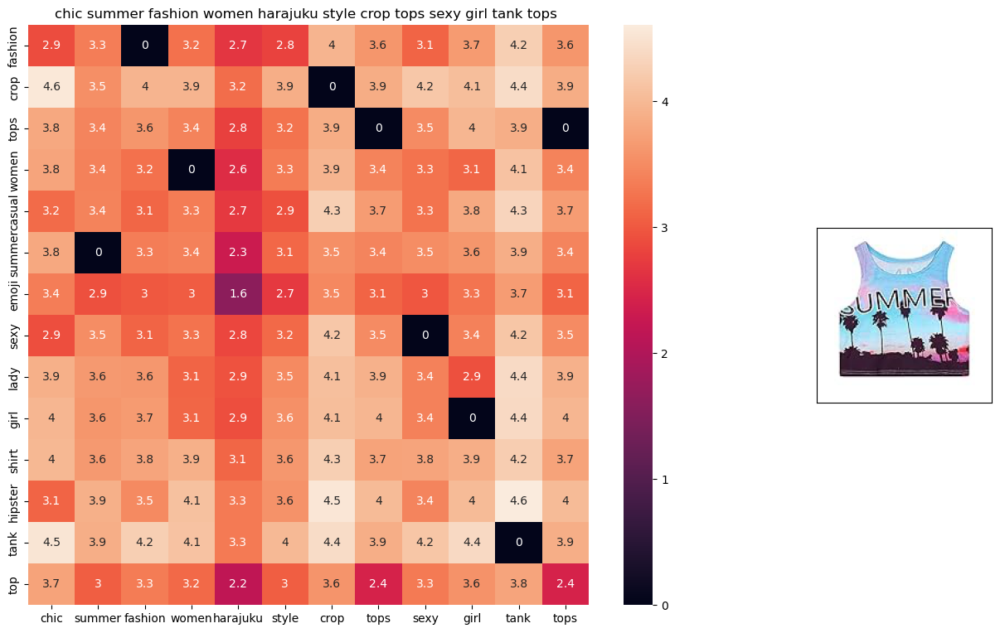

ASIN : B011OU51US
BRAND : Chiclook Cool
Title: chic summer fashion women harajuku style crop tops sexy girl tank tops 
euclidean distance from given input image : 0.5160891


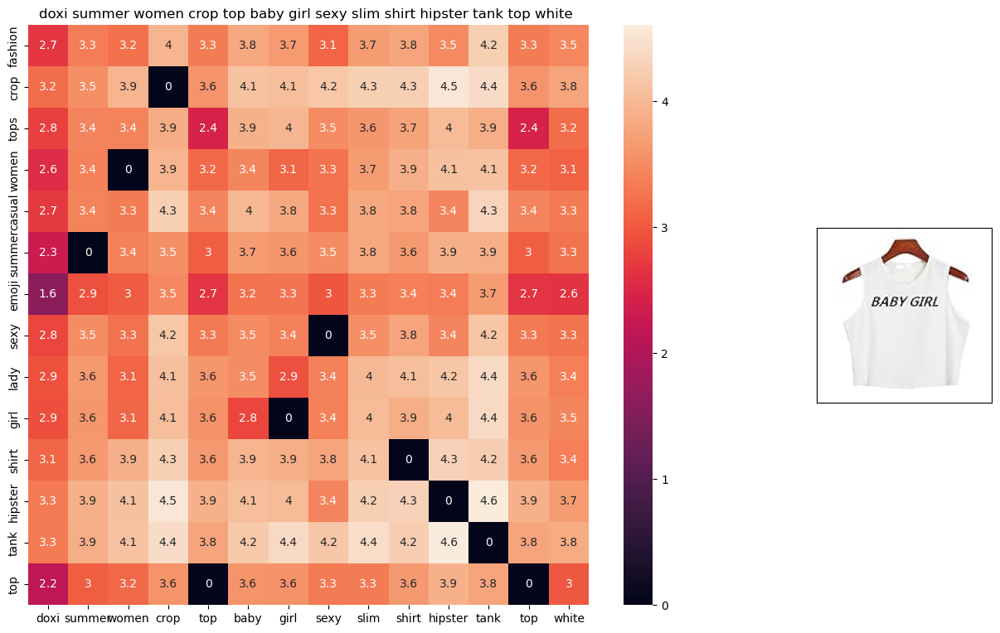

ASIN : B010V3A23U
BRAND : Doxi Supermall
Title: doxi summer women crop top baby girl sexy slim shirt hipster tank top white 
euclidean distance from given input image : 0.5262789


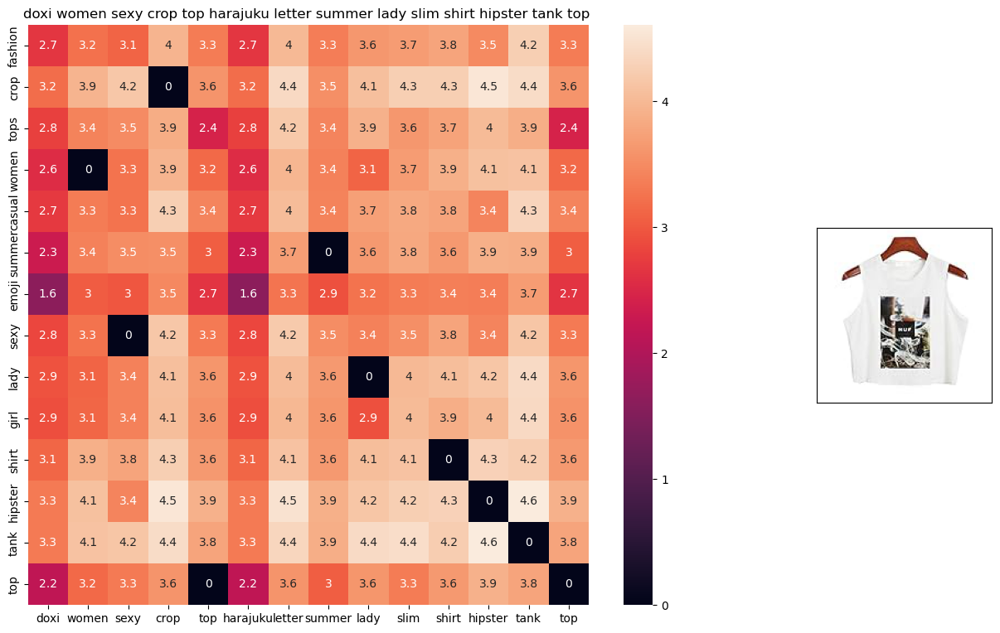

ASIN : B010V39146
BRAND : Doxi Supermall
Title: doxi women sexy crop top harajuku letter summer lady slim shirt hipster tank top 
euclidean distance from given input image : 0.5270717


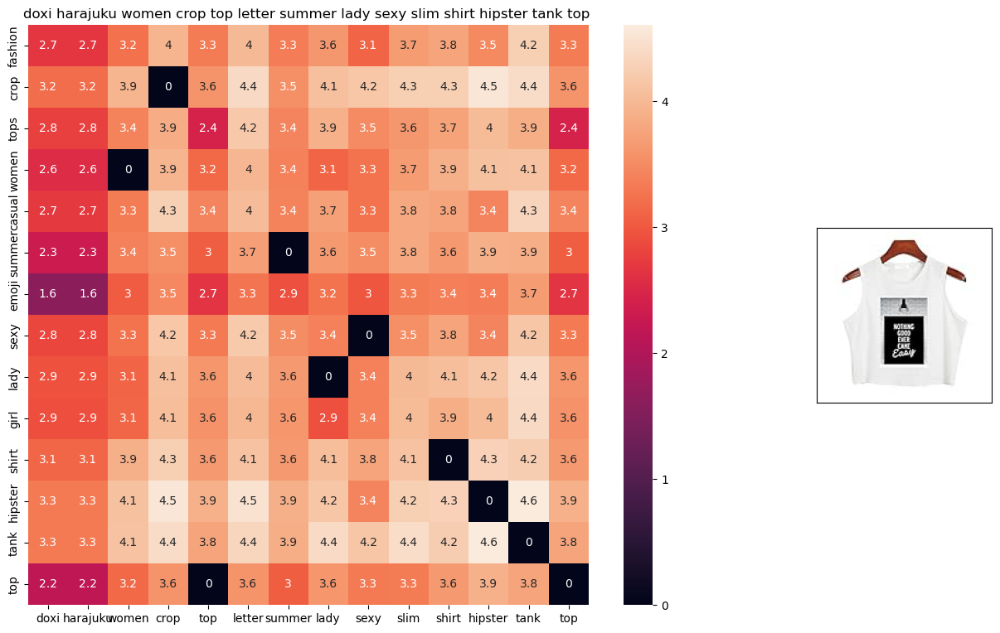

ASIN : B010V380LQ
BRAND : Doxi Supermall
Title: doxi harajuku women crop top letter summer lady sexy slim shirt hipster tank top 
euclidean distance from given input image : 0.5270717


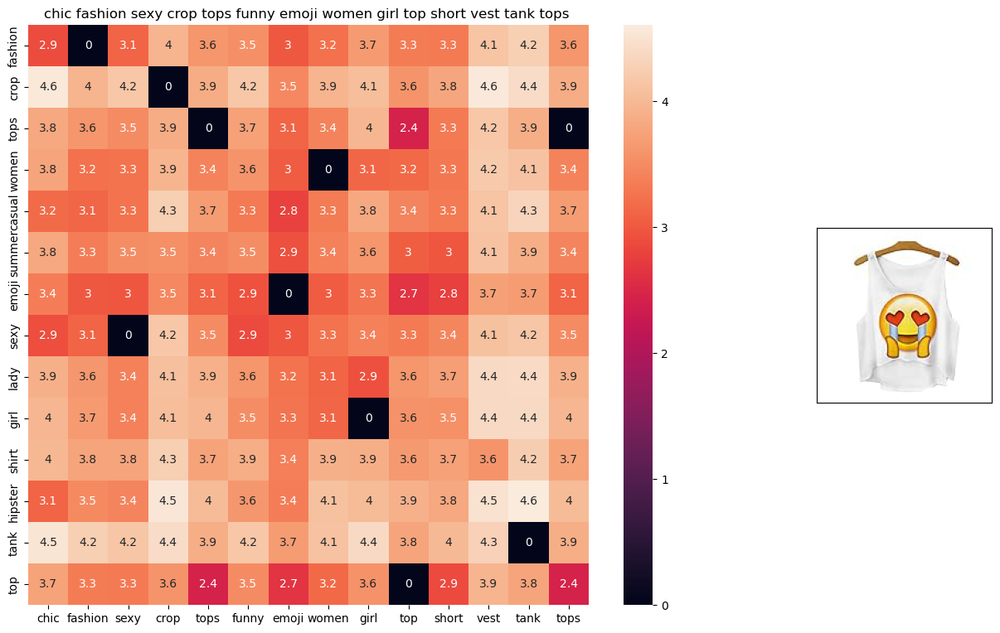

ASIN : B011RCJH58
BRAND : Chiclook Cool
Title: chic fashion sexy crop tops funny emoji women girl top short vest tank tops 
euclidean distance from given input image : 0.52816993


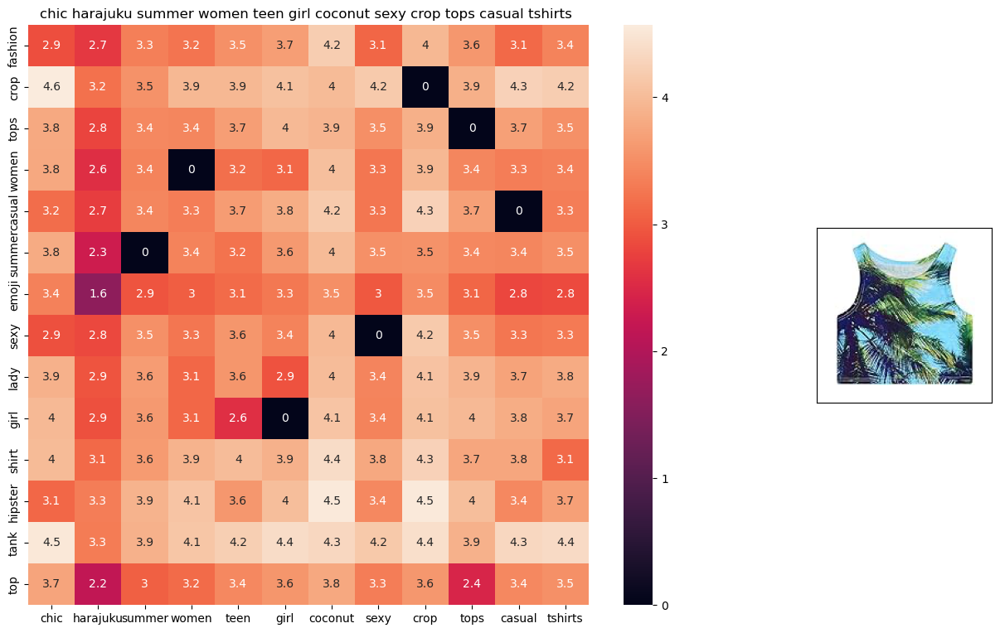

ASIN : B011OU4R08
BRAND : Chiclook Cool
Title: chic harajuku summer women teen girl coconut sexy crop tops casual tshirts 
euclidean distance from given input image : 0.5545634


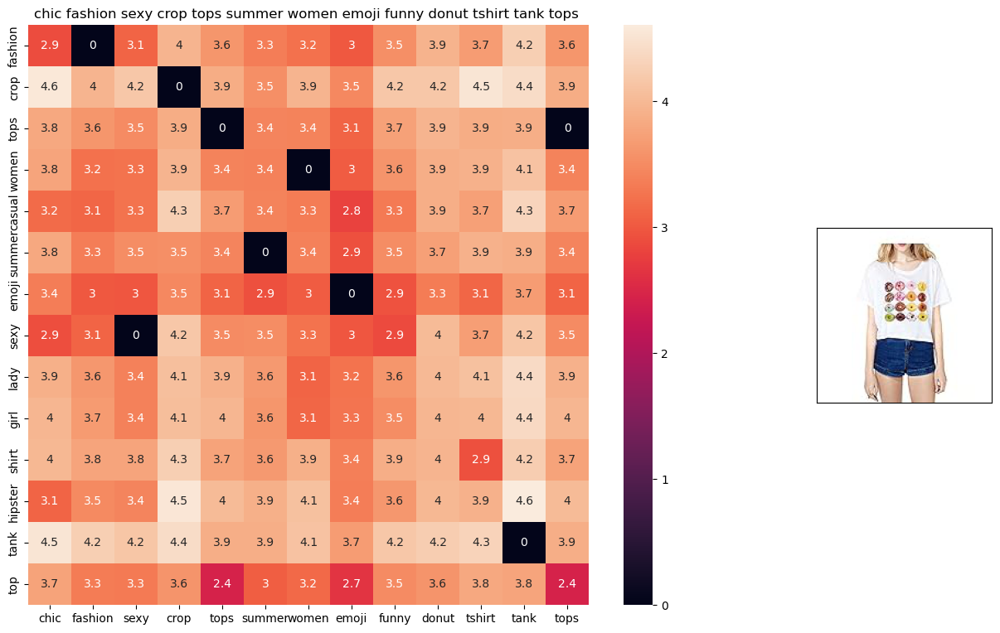

ASIN : B011UEUTQE
BRAND : Chiclook Cool
Title: chic fashion sexy crop tops summer women emoji funny donut tshirt tank tops 
euclidean distance from given input image : 0.57349175


In [149]:
def avg_w2v_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # dist(x, y) = sqrt(dot(x, x) - 2 * dot(x, y) + dot(y, y))
    pairwise_dist = pairwise_distances(w2v_title, w2v_title[doc_id].reshape(1,-1))

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    
    for i in range(0, len(indices)):
        heat_map_w2v(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i], 'avg')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('BRAND :',data['brand'].loc[df_indices[i]])
        print ('Title:', data['title'].loc[df_indices[i]])
        print ('euclidean distance from given input image :', pdists[i])
        print('='*125)

        
avg_w2v_model(12566, 20)
# in the give heat map, each cell contains the euclidean distance between words i, j


> <div class="alert alert-block alert-danger">
<b>Best Results right now - Result based on similarity of content in titles</b> 
</div>  


## TFIDF weighted Word2Vec

Ti = w1, w2, w3, w4, w5

w1 - word2vec(w1) * TFIDF(w1, Ti)<br>
w2 - word2vec(w2) * TFIDF(w2, Ti)<br>
.<br>
.<br>
w5 - word2vec(w5) * TFIDF(w5, Ti)<br>

<hr>Sum all vectors and take avg i.e 1/N(sum of vectors)

> TFIDF gives ***wordImportance*** + word2Vec gives ***Semantic Similarity***

## IDF Weighted Word2Vec for product similarity

In [138]:
doc_id = 0
w2v_title_weight = []
# for every title we build a weighted vector representation
for i in data['title']:
    w2v_title_weight.append(build_avg_vec(i, 300, doc_id,'weighted'))
    doc_id += 1
# w2v_title = np.array(# number of doc in courpus * 300), each row corresponds to a doc 
w2v_title_weight = np.array(w2v_title_weight)

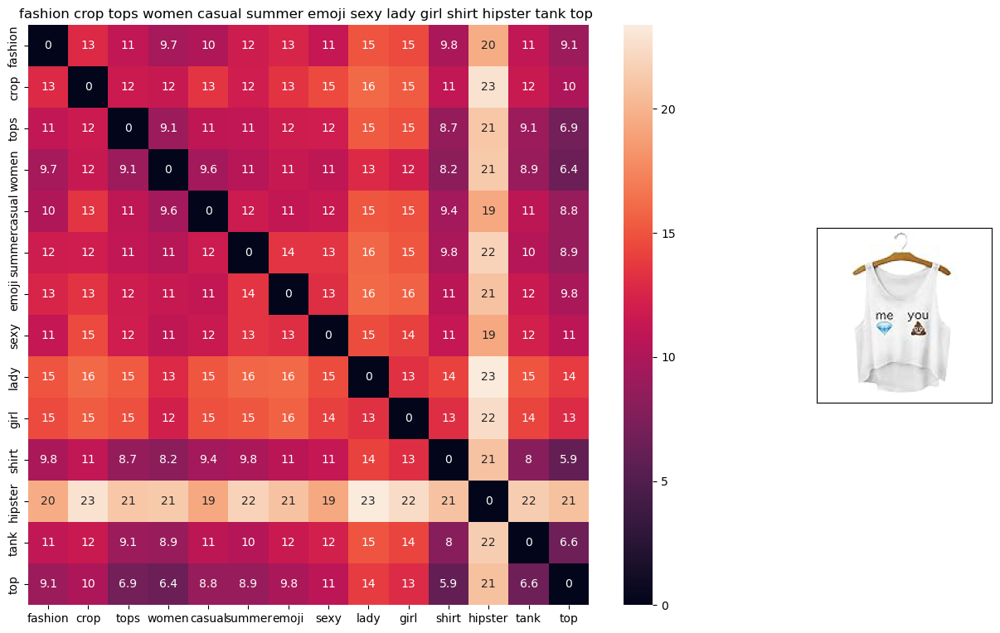

ASIN : B010V3B44G
Brand : Doxi Supermall
euclidean distance from input : 0.0


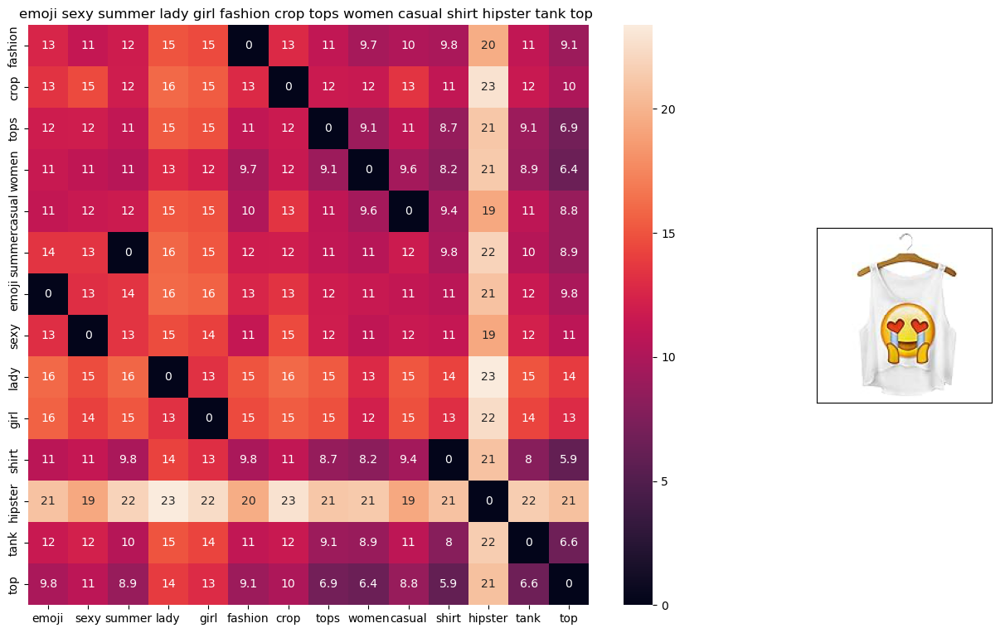

ASIN : B010V3BLWQ
Brand : Doxi Supermall
euclidean distance from input : 2.9200194e-07


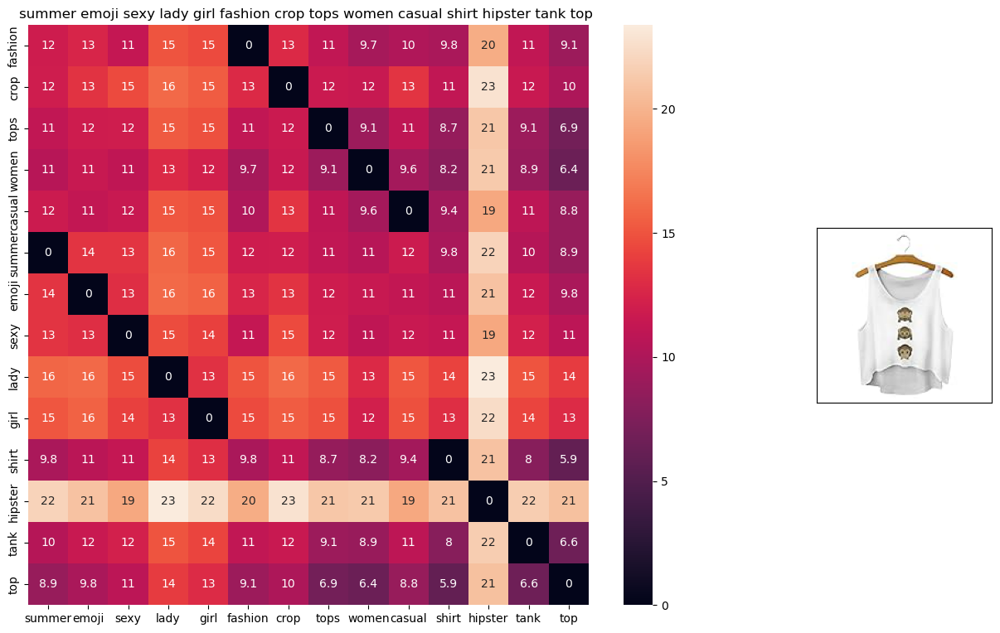

ASIN : B010V3BDII
Brand : Doxi Supermall
euclidean distance from input : 2.9200194e-07


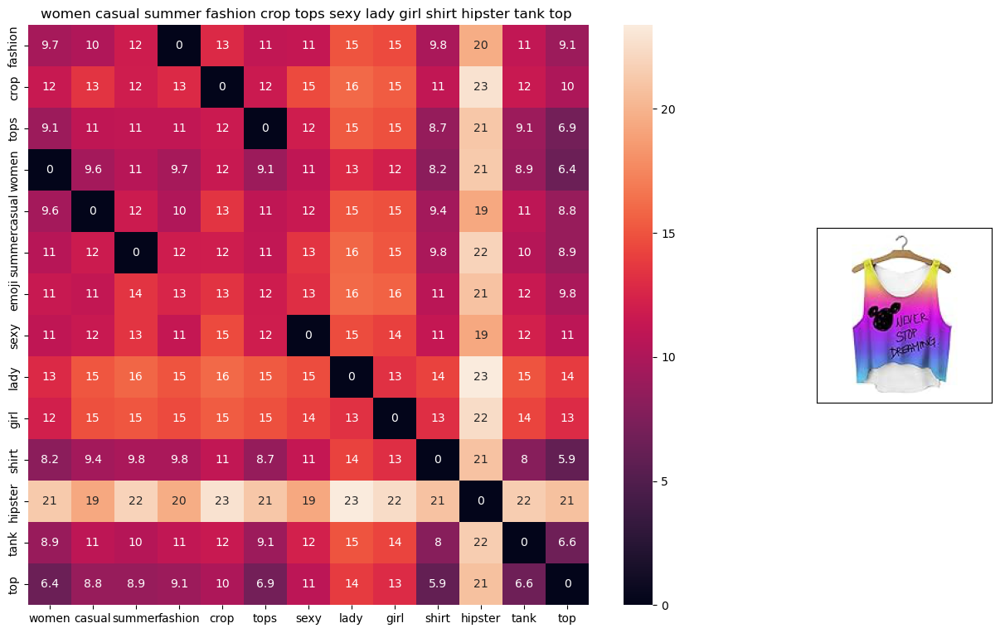

ASIN : B010V3AYSS
Brand : Doxi Supermall
euclidean distance from input : 0.6962319


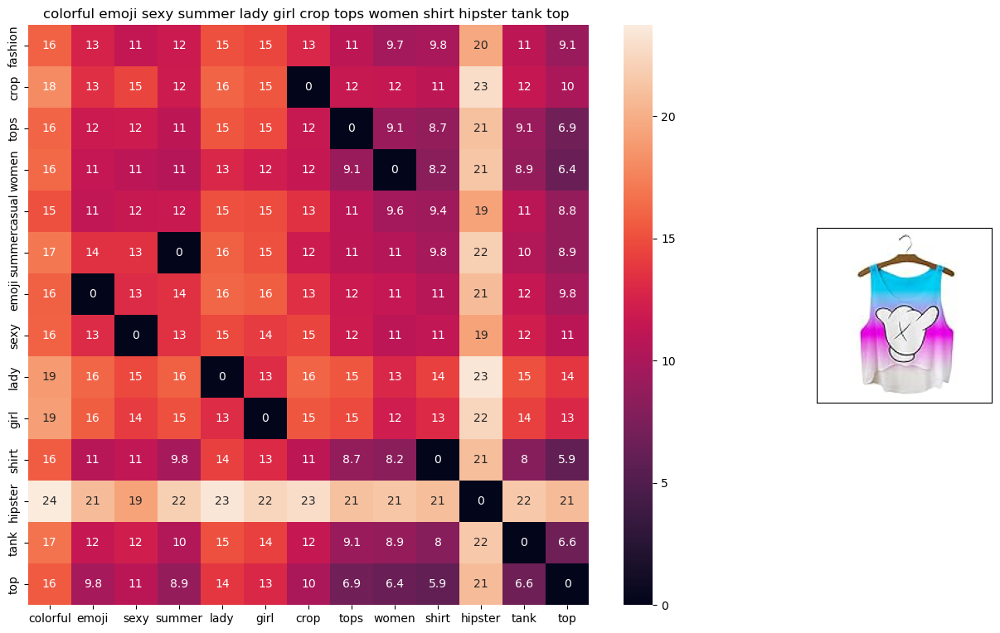

ASIN : B010V3BQZS
Brand : Doxi Supermall
euclidean distance from input : 1.2872719


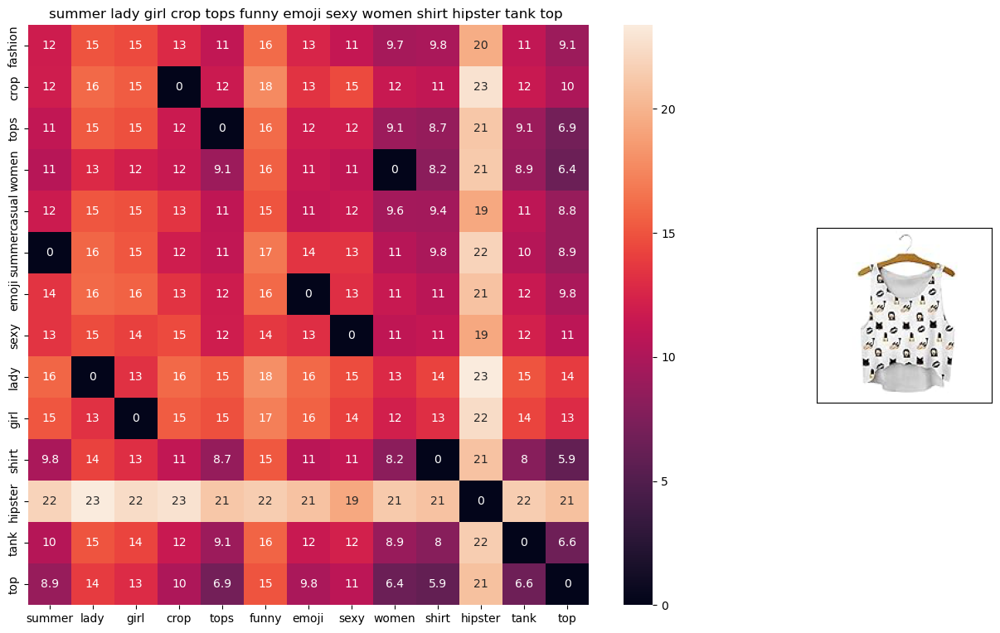

ASIN : B010V3BVMQ
Brand : Doxi Supermall
euclidean distance from input : 1.3530473


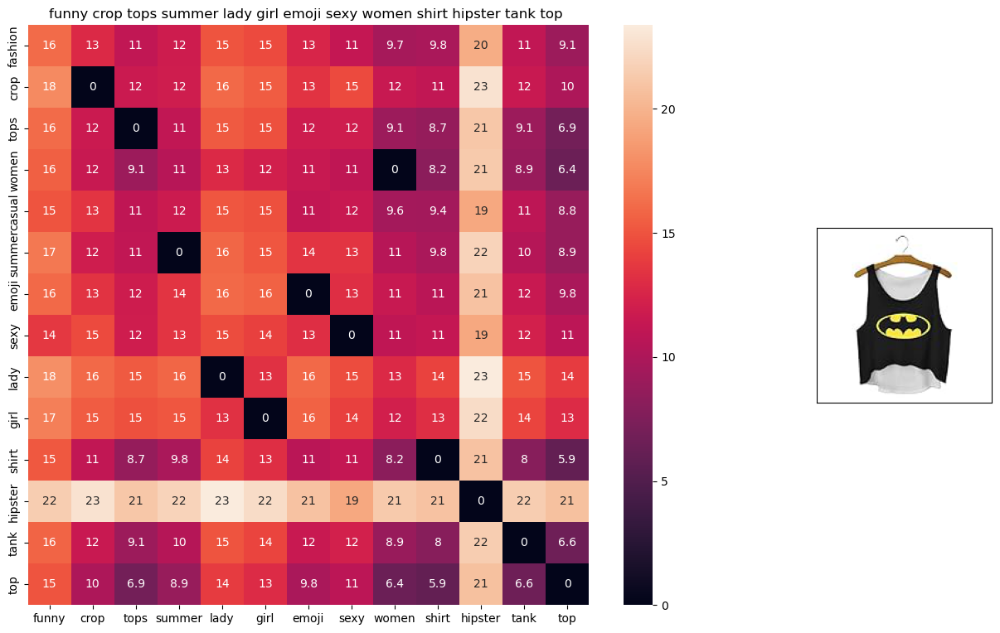

ASIN : B010V3C116
Brand : Doxi Supermall
euclidean distance from input : 1.3530474


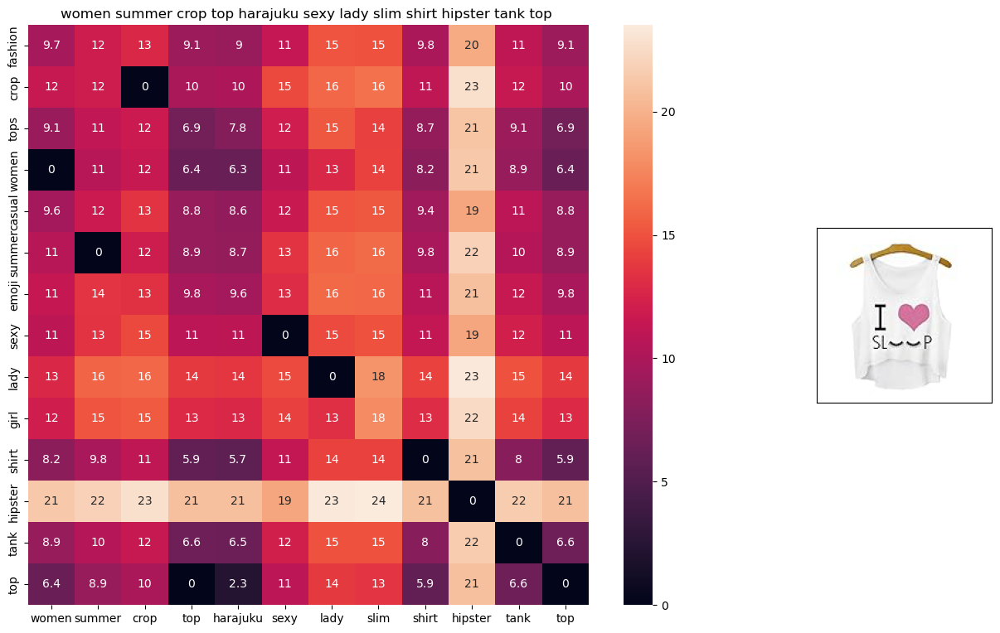

ASIN : B010V3EDEE
Brand : Doxi Supermall
euclidean distance from input : 1.7434151


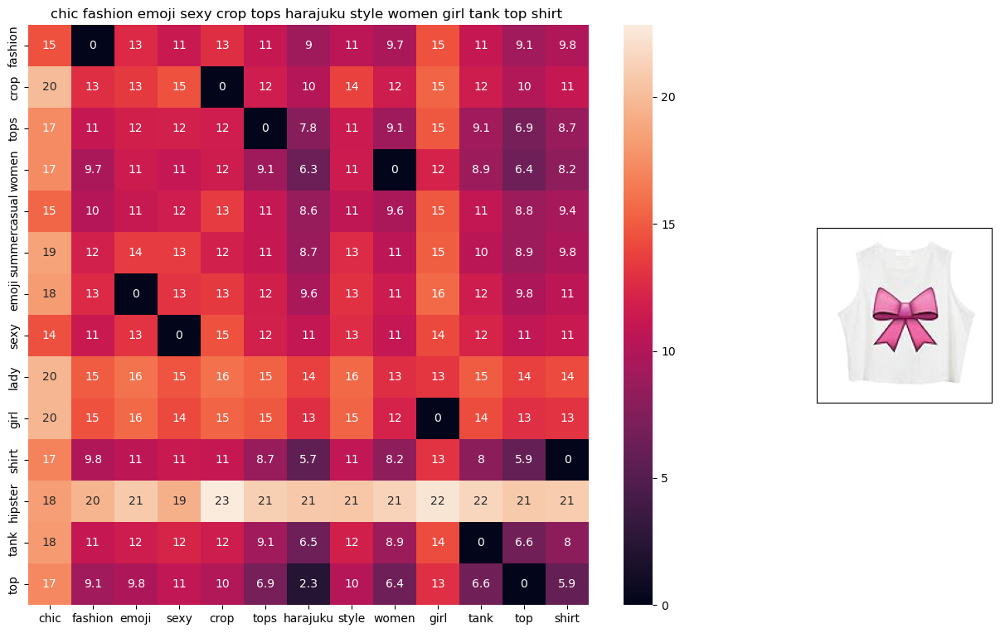

ASIN : B011RCJPR8
Brand : Chiclook Cool
euclidean distance from input : 1.934526


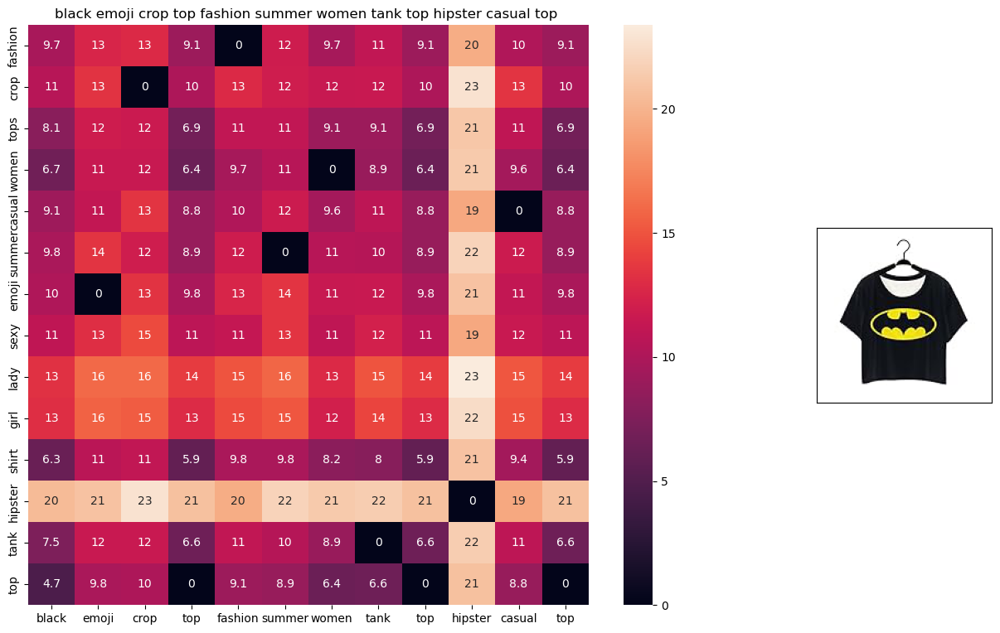

ASIN : B0124E80M4
Brand : Doxi Supermall
euclidean distance from input : 2.032144


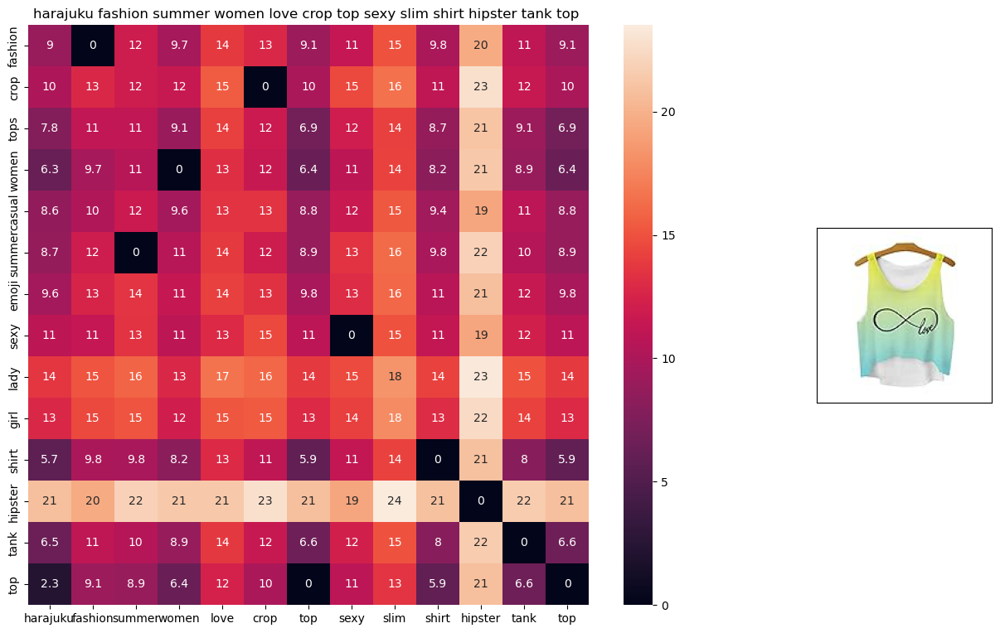

ASIN : B010V35OBU
Brand : Doxi Supermall
euclidean distance from input : 2.0631945


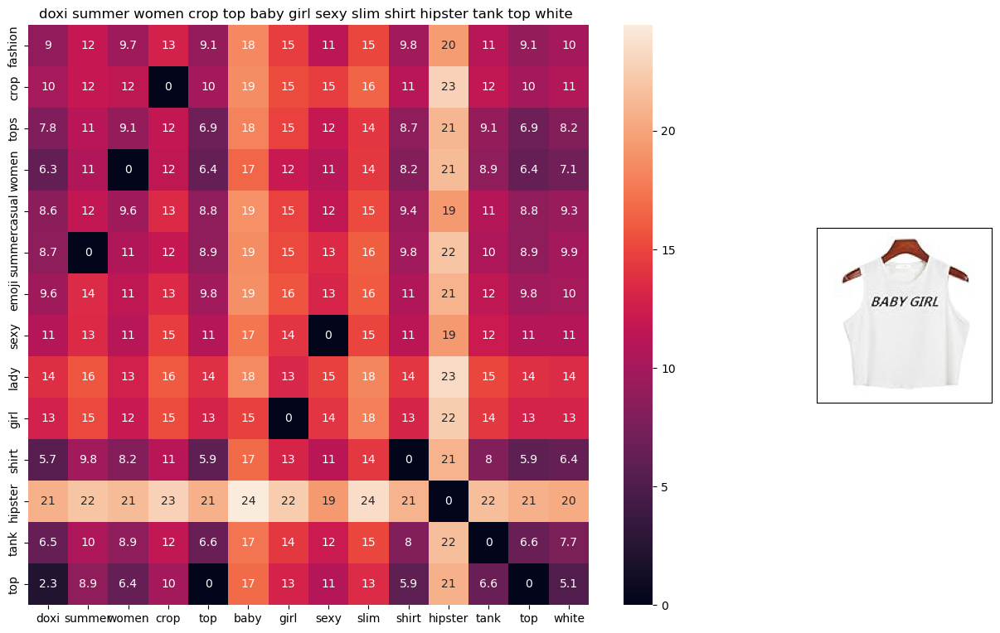

ASIN : B010V3A23U
Brand : Doxi Supermall
euclidean distance from input : 2.1243675


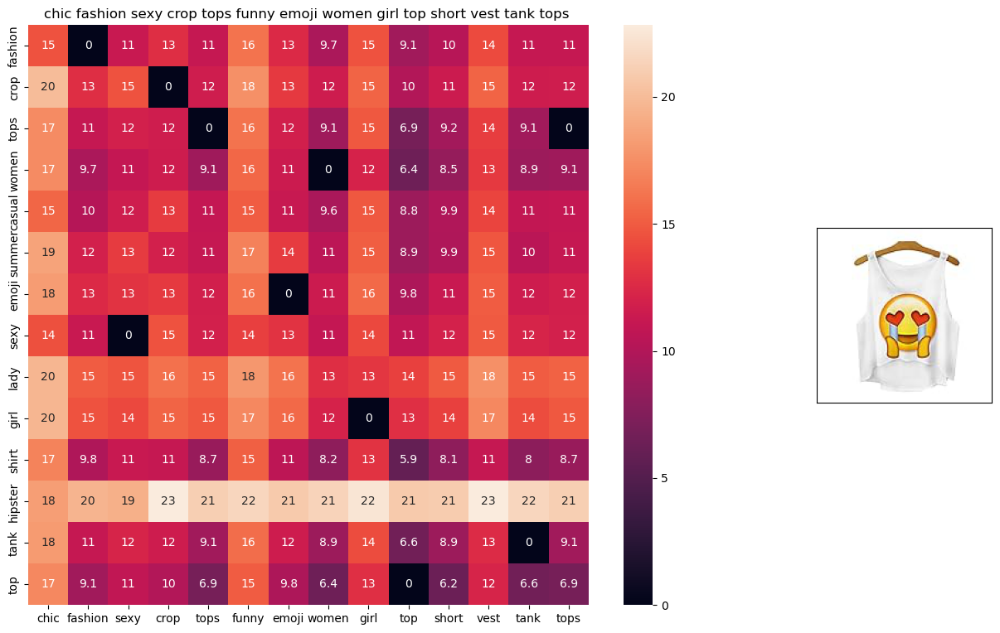

ASIN : B011RCJH58
Brand : Chiclook Cool
euclidean distance from input : 2.1507077


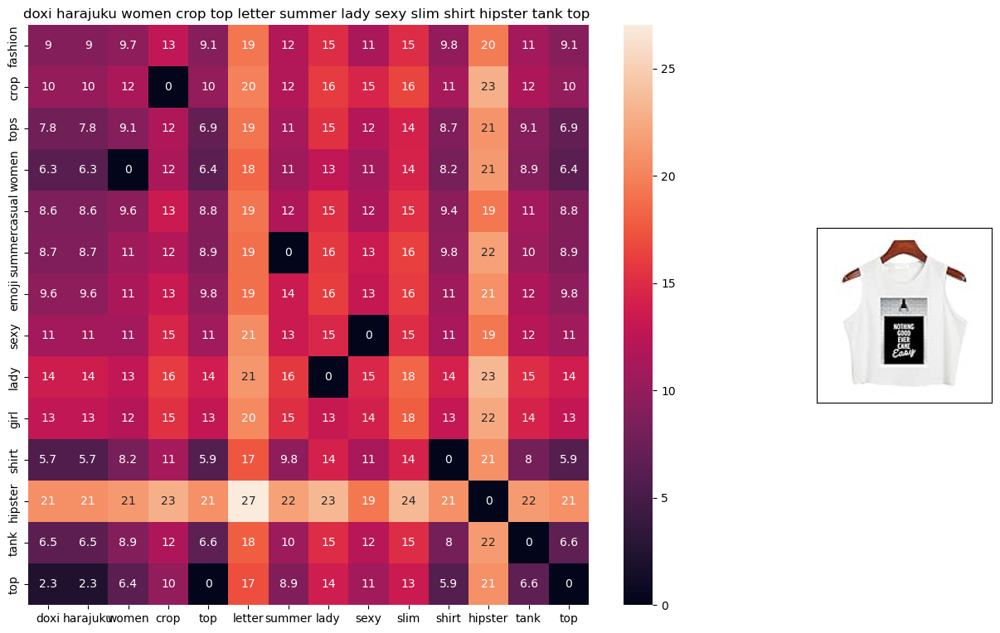

ASIN : B010V380LQ
Brand : Doxi Supermall
euclidean distance from input : 2.1674914


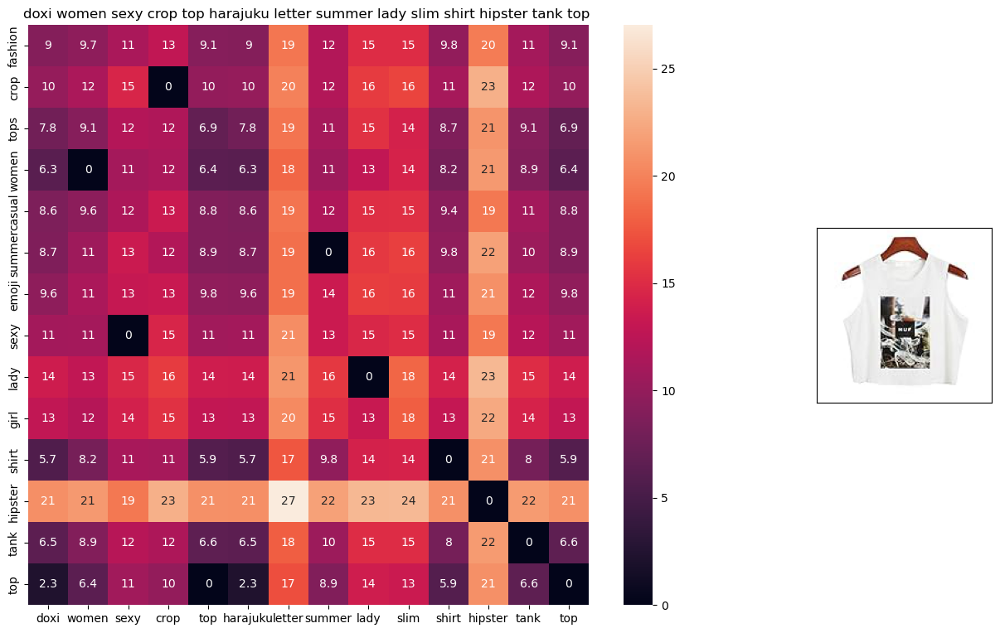

ASIN : B010V39146
Brand : Doxi Supermall
euclidean distance from input : 2.1674914


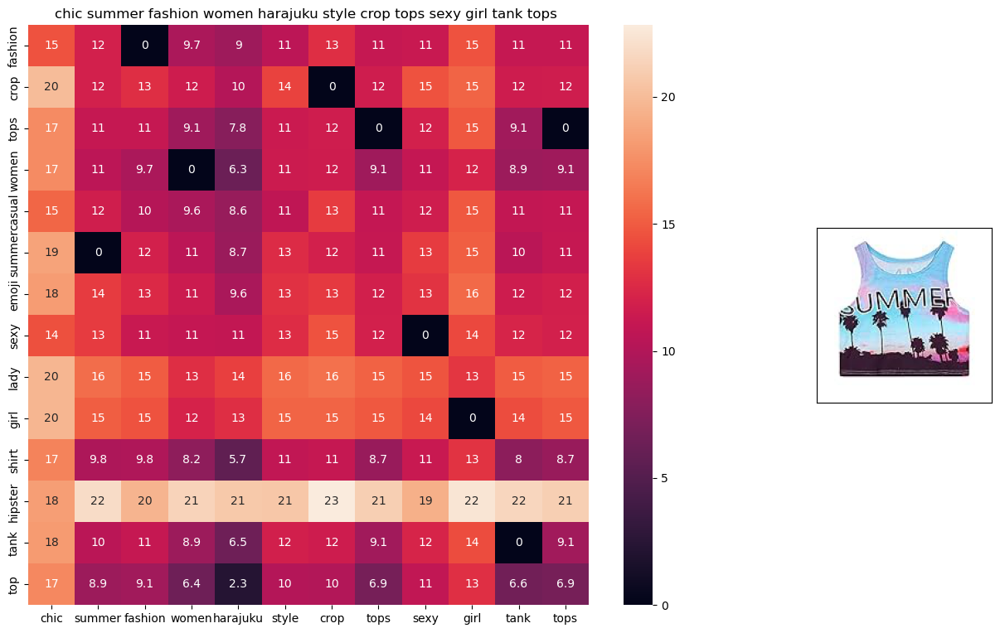

ASIN : B011OU51US
Brand : Chiclook Cool
euclidean distance from input : 2.2320173


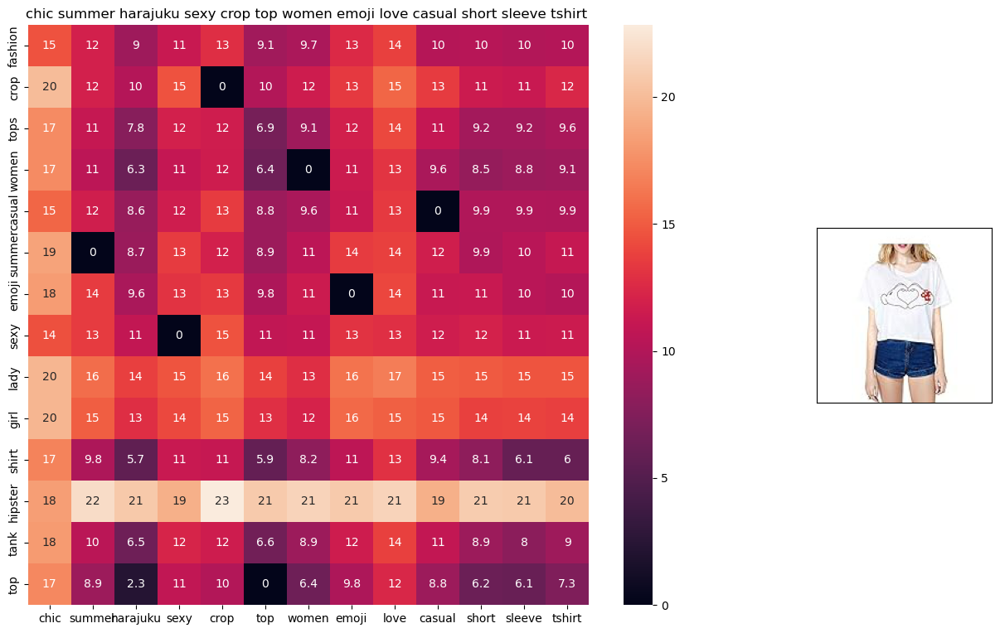

ASIN : B011UEVF4O
Brand : Chiclook Cool
euclidean distance from input : 2.3134534


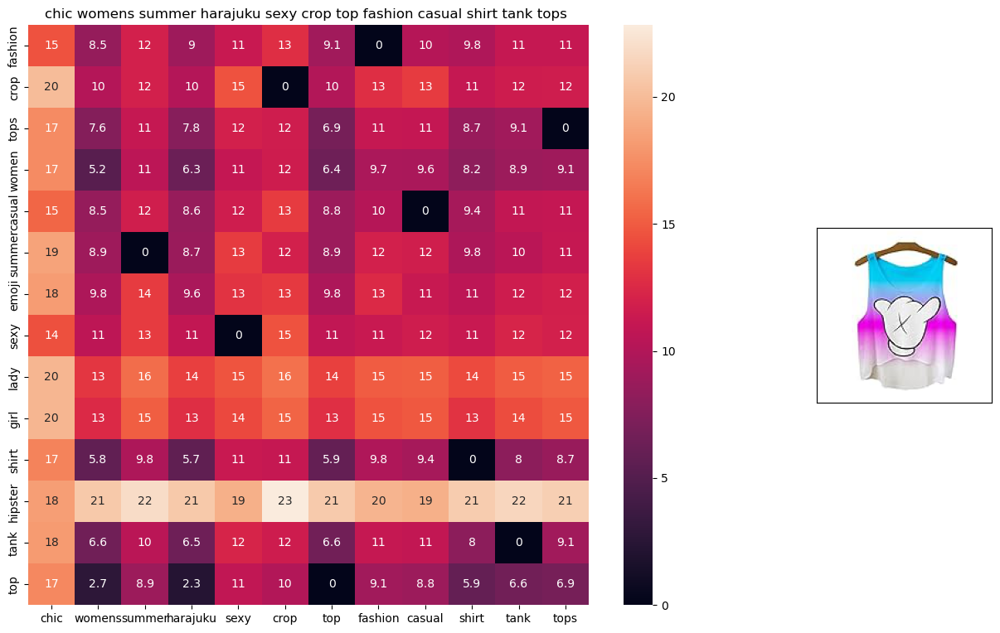

ASIN : B011RCJEMO
Brand : Chiclook Cool
euclidean distance from input : 2.3378792


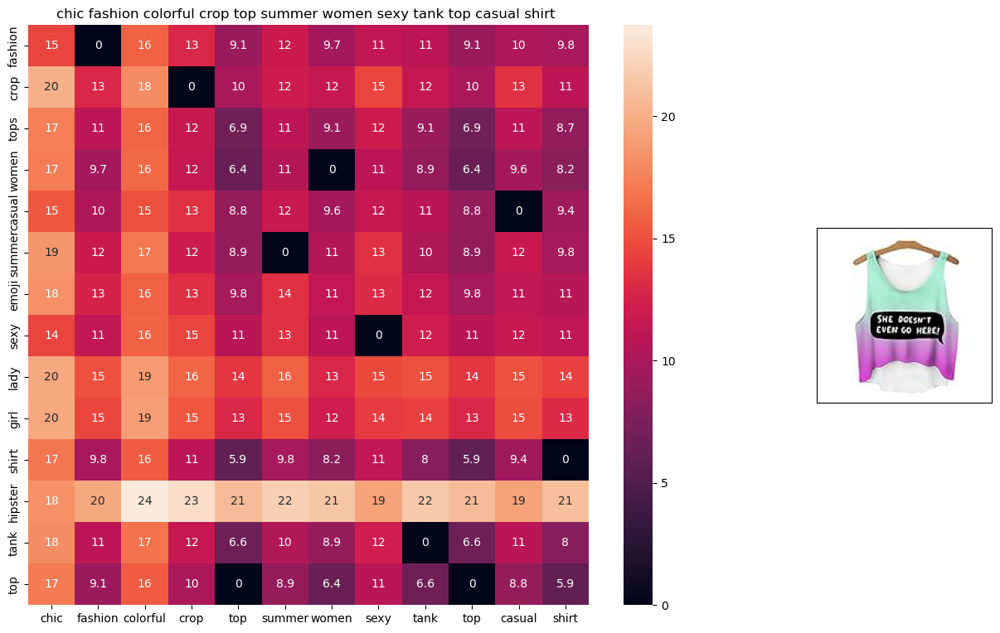

ASIN : B011RCJ6UE
Brand : Chiclook Cool
euclidean distance from input : 2.5151837


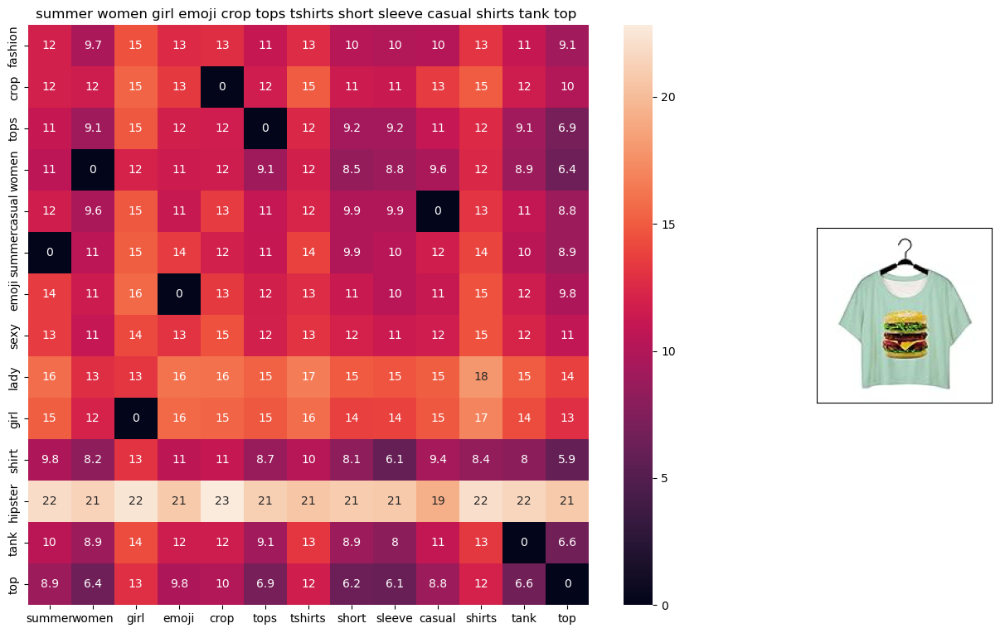

ASIN : B0124ECIU4
Brand : Doxi Supermall
euclidean distance from input : 2.5520847


In [145]:
def weighted_w2v_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(w2v_title_weight, w2v_title_weight[doc_id].reshape(1,-1))

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    
    for i in range(0, len(indices)):
        heat_map_w2v(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i], 'weighted')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print('euclidean distance from input :', pdists[i])
        print('='*125)

weighted_w2v_model(12566, 20)
#931
#12566

## Weighted Similarity using Brand and Colorm

> Concatenate brand and color one hot encodded vectors to title vector

In [151]:
# some of the brand values are empty. 
# Need to replace Null with string "NULL"
data['brand'].fillna(value="Not given", inplace=True )

# replace spaces with hypen
brands = [x.replace(" ", "-") for x in data['brand'].values]
types = [x.replace(" ", "-") for x in data['product_type_name'].values]
colors = [x.replace(" ", "-") for x in data['color'].values]

brand_vectorizer = CountVectorizer()
brand_features = brand_vectorizer.fit_transform(brands)

type_vectorizer = CountVectorizer()
type_features = type_vectorizer.fit_transform(types)

color_vectorizer = CountVectorizer()
color_features = color_vectorizer.fit_transform(colors)

extra_features = hstack((brand_features, type_features, color_features)).tocsr()


In [152]:
def heat_map_w2v_brand(sentance1, sentance2, url, doc_id1, doc_id2, df_id1, df_id2, model):
    
    # sentance1 : title1, input apparel
    # sentance2 : title2, recommended apparel
    # url: apparel image url
    # doc_id1: document id of input apparel
    # doc_id2: document id of recommended apparel
    # df_id1: index of document1 in the data frame
    # df_id2: index of document2 in the data frame
    # model: it can have two values, 1. avg 2. weighted
    
    #s1_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s1_vec = get_word_vec(sentance1, doc_id1, model)
    #s2_vec = np.array(#number_of_words_title2 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s2_vec = get_word_vec(sentance2, doc_id2, model)
    
    # s1_s2_dist = np.array(#number of words in title1 * #number of words in title2)
    # s1_s2_dist[i,j] = euclidean distance between words i, j
    s1_s2_dist = get_distance(s1_vec, s2_vec)
   
    data_matrix = [['Asin','Brand', 'Color', 'Product type'],
               [data['asin'].loc[df_id1],brands[doc_id1], colors[doc_id1], types[doc_id1]], # input apparel's features
               [data['asin'].loc[df_id2],brands[doc_id2], colors[doc_id2], types[doc_id2]]] # recommonded apparel's features
    
    colorscale = [[0, '#1d004d'],[.5, '#f2e5ff'],[1, '#f2e5d1']] # to color the headings of each column 
    
    # we create a table with the data_matrix
    table = ff.create_table(data_matrix, index=True, colorscale=colorscale)
    # plot it with plotly
    plotly.offline.iplot(table, filename='simple_table')
    
    # devide whole figure space into 25 * 1:10 grids
    gs = gridspec.GridSpec(25, 15)
    fig = plt.figure(figsize=(25,5))
    
    # in first 25*10 grids we plot heatmap
    ax1 = plt.subplot(gs[:, :-5])
    # ploting the heap map based on the pairwise distances
    ax1 = sns.heatmap(np.round(s1_s2_dist,6), annot=True)
    # set the x axis labels as recommended apparels title
    ax1.set_xticklabels(sentance2.split())
    # set the y axis labels as input apparels title
    ax1.set_yticklabels(sentance1.split())
    # set title as recommended apparels title
    ax1.set_title(sentance2)

    # in last 25 * 10:15 grids we display image
    ax2 = plt.subplot(gs[:, 10:16])
    # we dont display grid lins and axis labels to images
    ax2.grid(False)
    ax2.set_xticks([])
    ax2.set_yticks([])
    
    # pass the url it display it
    display_img(url, ax2, fig)
    
    plt.show()

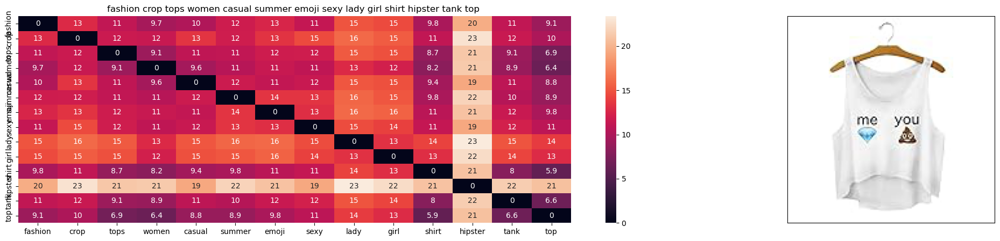

ASIN : B010V3B44G
Brand : Doxi Supermall
euclidean distance from input : 0.0


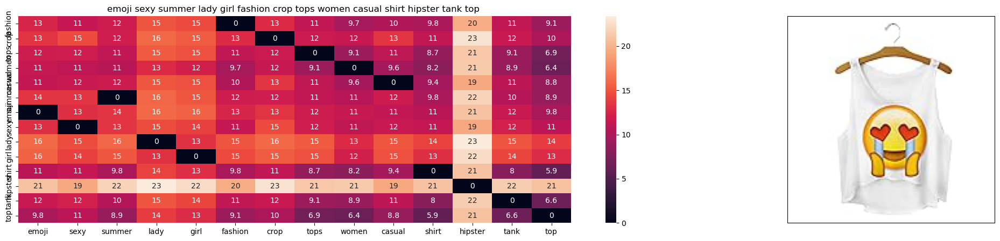

ASIN : B010V3BLWQ
Brand : Doxi Supermall
euclidean distance from input : 1.460009684706165e-07


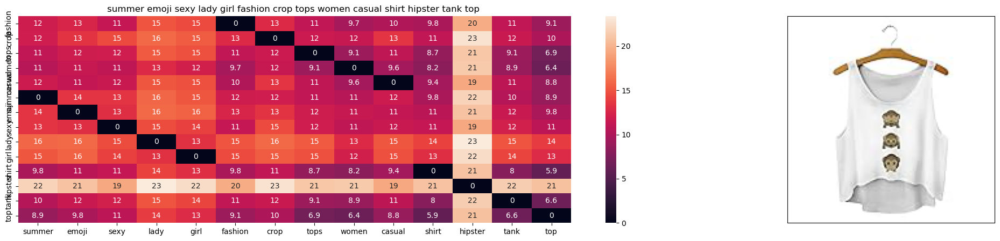

ASIN : B010V3BDII
Brand : Doxi Supermall
euclidean distance from input : 1.460009684706165e-07


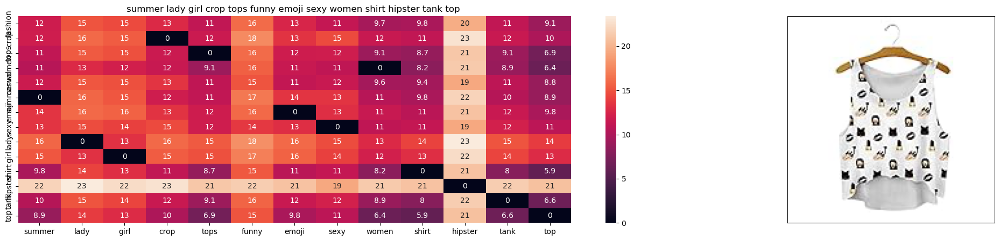

ASIN : B010V3BVMQ
Brand : Doxi Supermall
euclidean distance from input : 0.6765236377716064


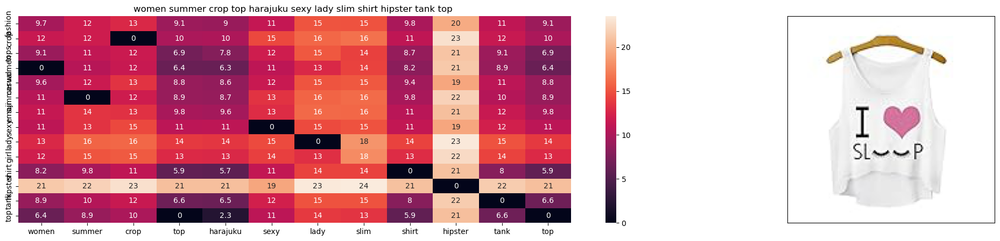

ASIN : B010V3EDEE
Brand : Doxi Supermall
euclidean distance from input : 0.871707534790039


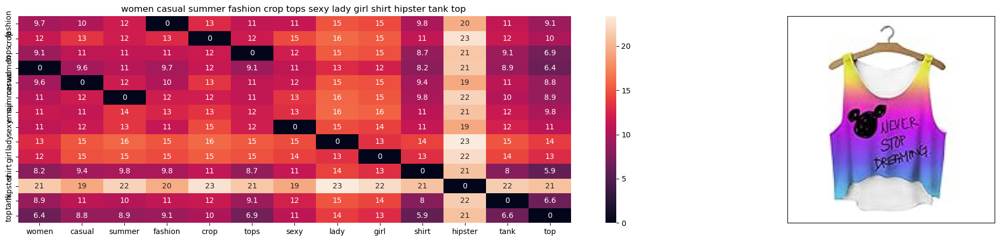

ASIN : B010V3AYSS
Brand : Doxi Supermall
euclidean distance from input : 1.0552227260489133


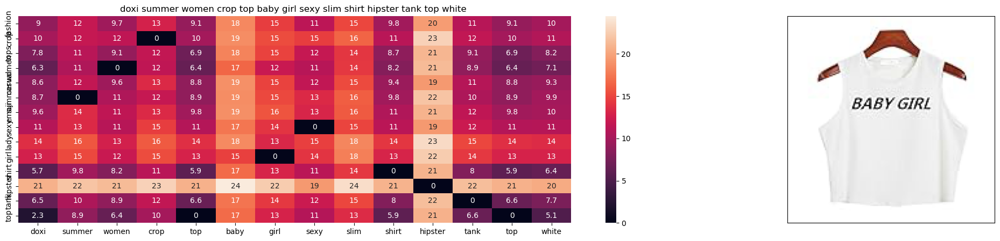

ASIN : B010V3A23U
Brand : Doxi Supermall
euclidean distance from input : 1.0621837615966796


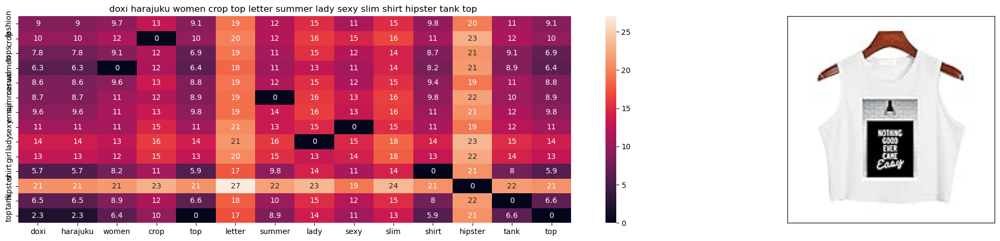

ASIN : B010V380LQ
Brand : Doxi Supermall
euclidean distance from input : 1.0837457656860352


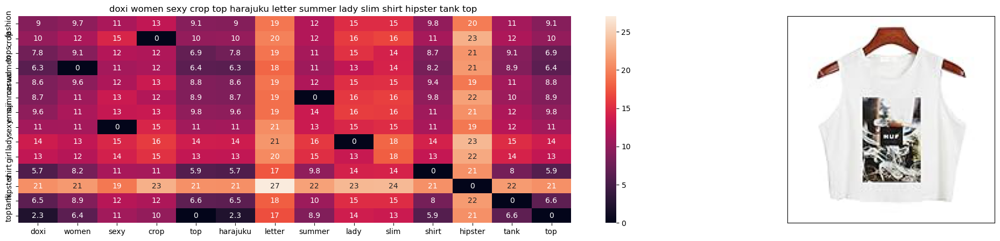

ASIN : B010V39146
Brand : Doxi Supermall
euclidean distance from input : 1.0837457656860352


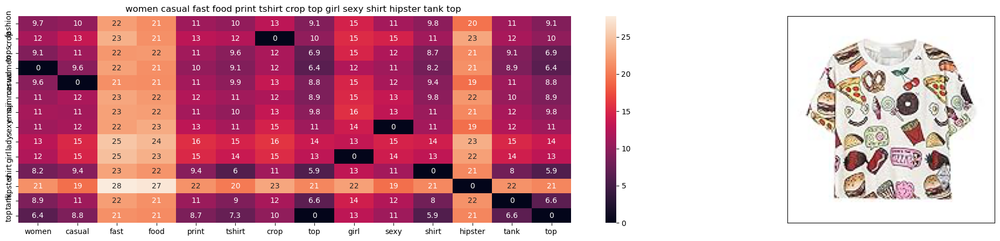

ASIN : B010V3AB5O
Brand : Doxi Supermall
euclidean distance from input : 1.3135894775390624


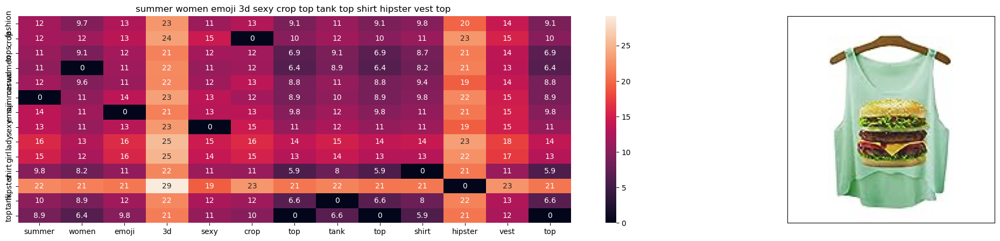

ASIN : B010V3E5EC
Brand : Doxi Supermall
euclidean distance from input : 1.3397350311279297


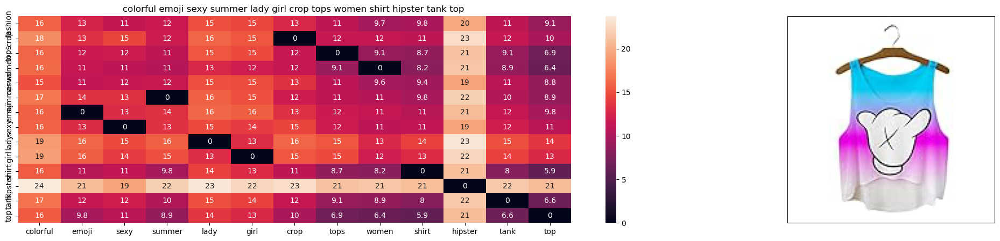

ASIN : B010V3BQZS
Brand : Doxi Supermall
euclidean distance from input : 1.3507427217383055


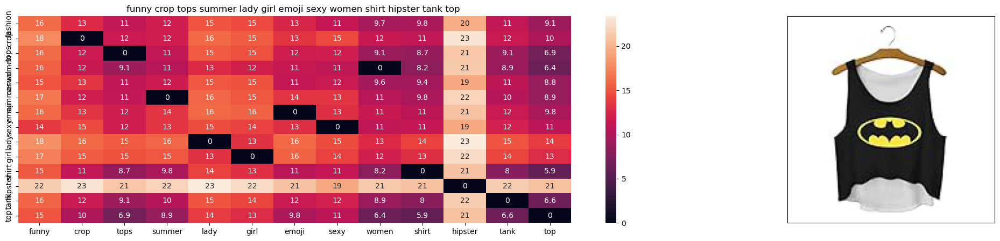

ASIN : B010V3C116
Brand : Doxi Supermall
euclidean distance from input : 1.3836304666418697


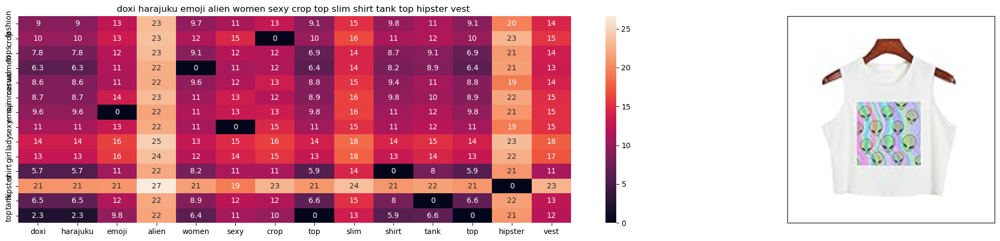

ASIN : B010TKXAI4
Brand : Doxi Supermall
euclidean distance from input : 1.387600803375244


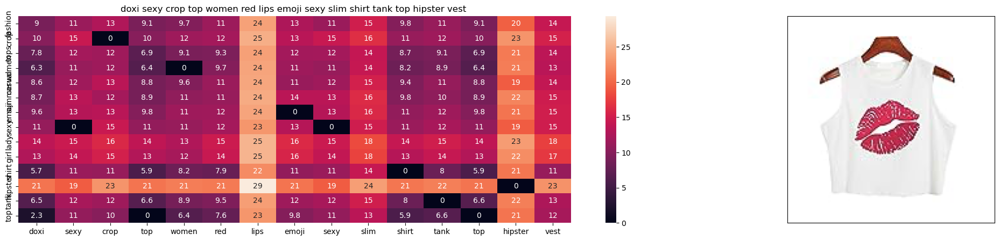

ASIN : B010TKXEHG
Brand : Doxi Supermall
euclidean distance from input : 1.4269560813903808


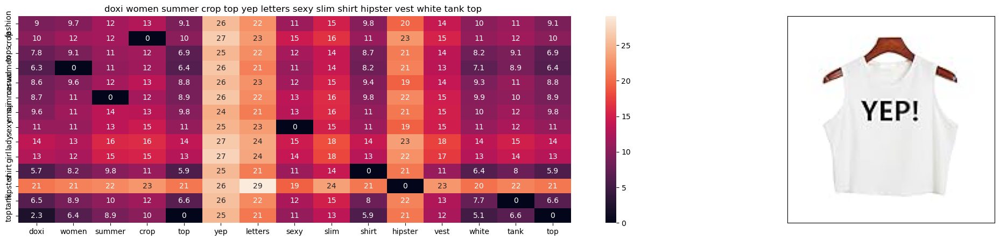

ASIN : B010V3487Q
Brand : Doxi Supermall
euclidean distance from input : 1.4681865692138671


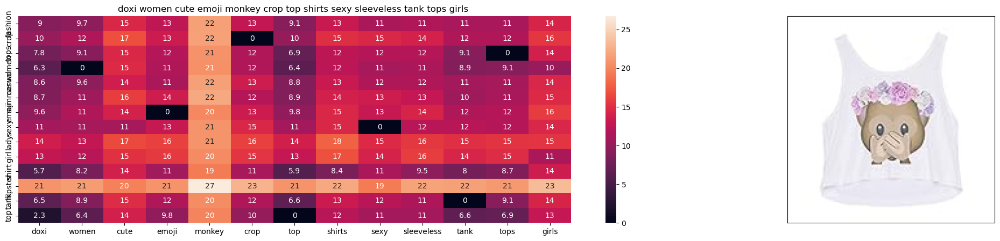

ASIN : B01LF90QTO
Brand : Doxi Supermall
euclidean distance from input : 1.4761534690856934


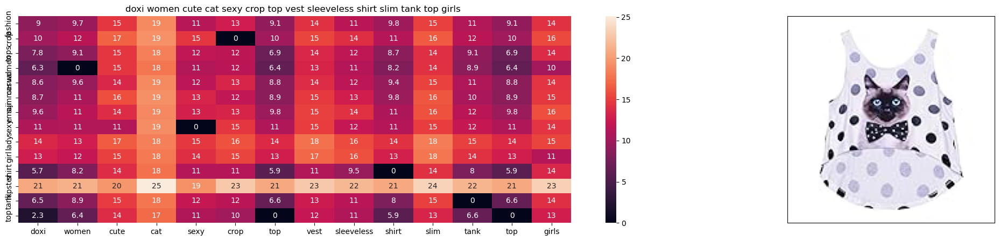

ASIN : B01LF90ROI
Brand : Doxi Supermall
euclidean distance from input : 1.482174777984619


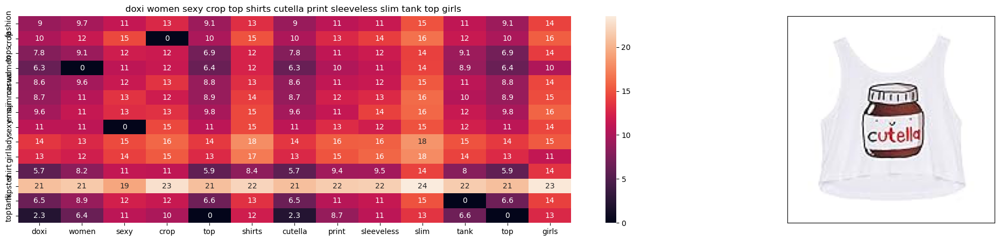

ASIN : B01LF90RKC
Brand : Doxi Supermall
euclidean distance from input : 1.5058938980102539


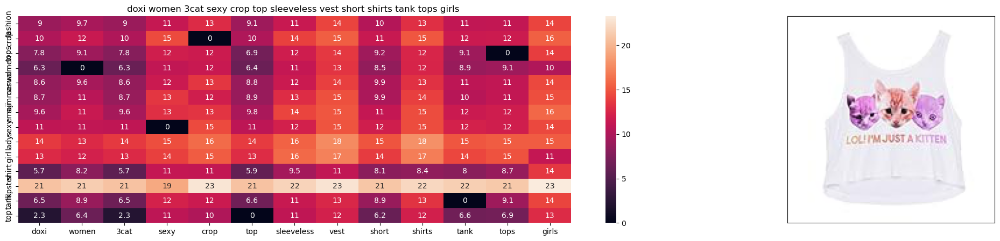

ASIN : B01LY4GQY0
Brand : Doxi Supermall
euclidean distance from input : 1.509817886352539


In [153]:
def idf_w2v_brand(doc_id, w1, w2, num_results):
    # doc_id: apparel's id in given corpus
    # w1: weight for  w2v features
    # w2: weight for brand and color features

    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    idf_w2v_dist  = pairwise_distances(w2v_title_weight, w2v_title_weight[doc_id].reshape(1,-1))
    ex_feat_dist = pairwise_distances(extra_features, extra_features[doc_id])
    pairwise_dist   = (w1 * idf_w2v_dist +  w2 * ex_feat_dist)/float(w1 + w2)

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    

    for i in range(0, len(indices)):
        heat_map_w2v_brand(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i],df_indices[0], df_indices[i], 'weighted')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print('euclidean distance from input :', pdists[i])
        print('='*125)

idf_w2v_brand(12566, 5, 5, 20)
# in the give heat map, each cell contains the euclidean distance between words i, j

>>> Prefers same brand and same color<hr> 
>>> To give more weightage to same brand weights are associated while concatenation/combining

* Giving more weight to same brand

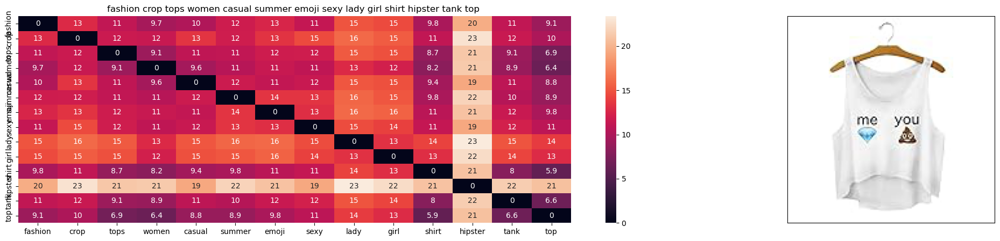

ASIN : B010V3B44G
Brand : Doxi Supermall
euclidean distance from input : 0.0


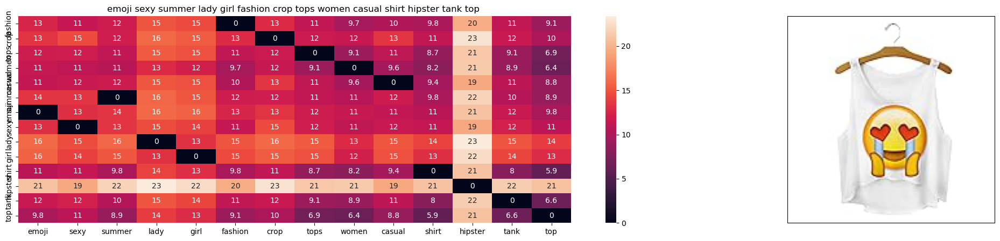

ASIN : B010V3BLWQ
Brand : Doxi Supermall
euclidean distance from input : 2.6545630631021182e-08


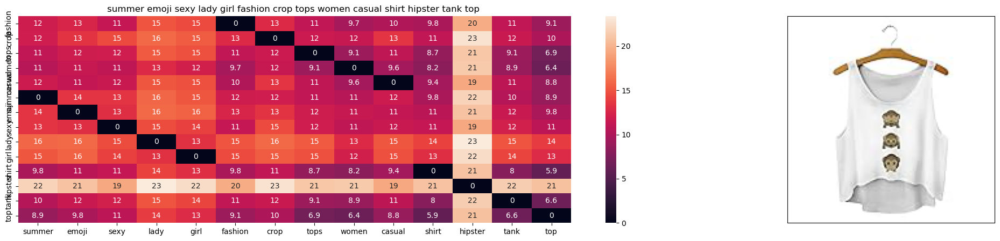

ASIN : B010V3BDII
Brand : Doxi Supermall
euclidean distance from input : 2.6545630631021182e-08


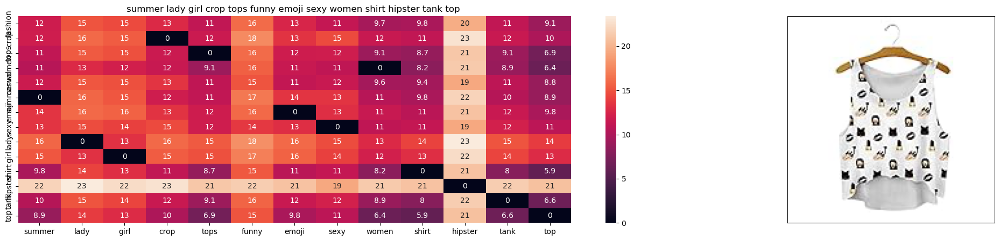

ASIN : B010V3BVMQ
Brand : Doxi Supermall
euclidean distance from input : 0.12300429777665571


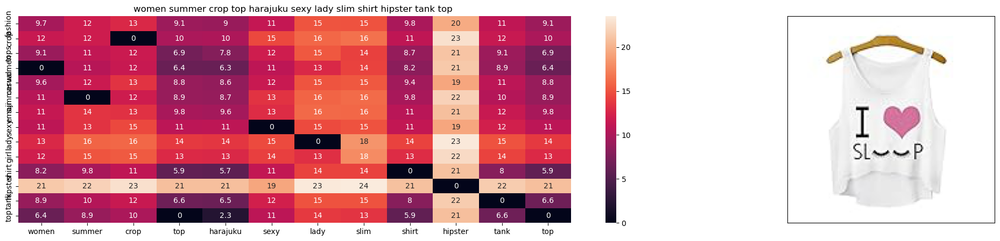

ASIN : B010V3EDEE
Brand : Doxi Supermall
euclidean distance from input : 0.15849227905273439


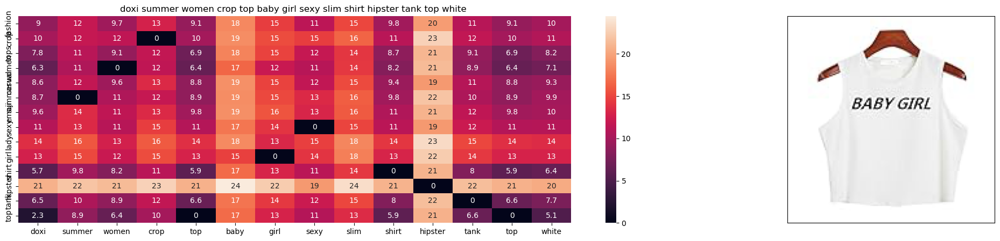

ASIN : B010V3A23U
Brand : Doxi Supermall
euclidean distance from input : 0.1931243202903054


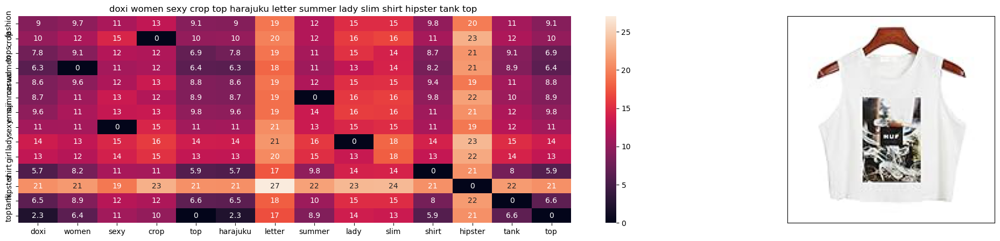

ASIN : B010V39146
Brand : Doxi Supermall
euclidean distance from input : 0.1970446846701882


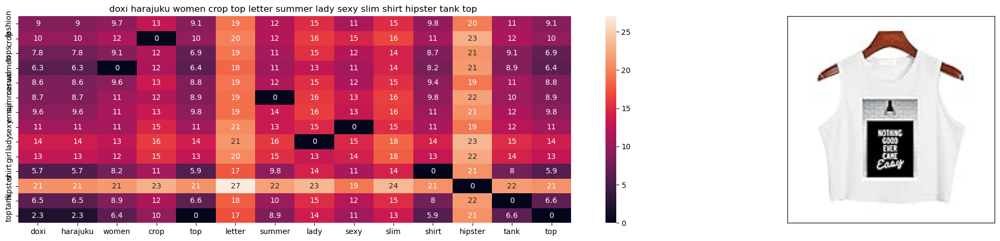

ASIN : B010V380LQ
Brand : Doxi Supermall
euclidean distance from input : 0.1970446846701882


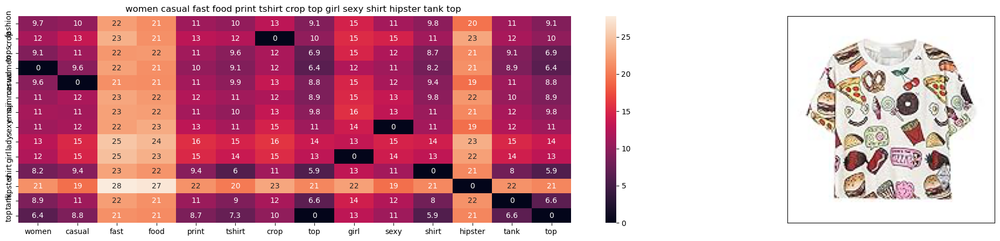

ASIN : B010V3AB5O
Brand : Doxi Supermall
euclidean distance from input : 0.23883445046164772


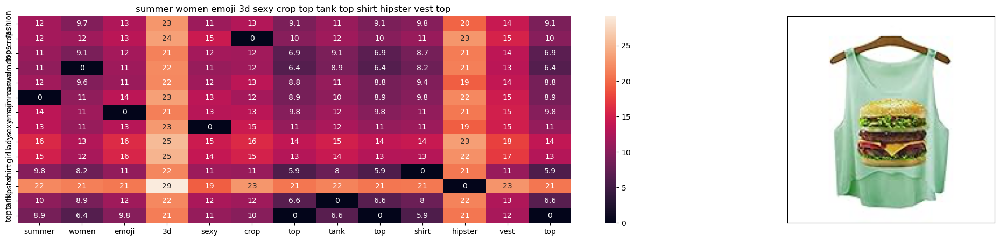

ASIN : B010V3E5EC
Brand : Doxi Supermall
euclidean distance from input : 0.2435881874778054


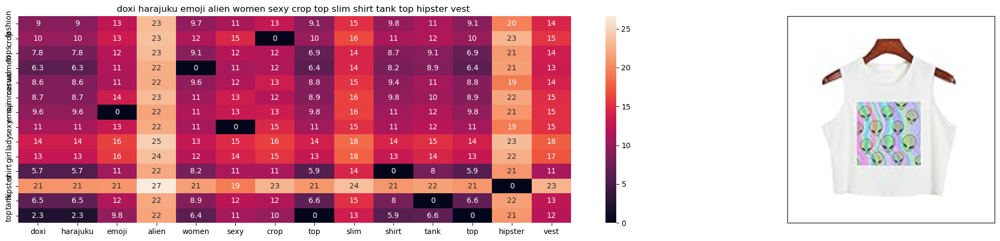

ASIN : B010TKXAI4
Brand : Doxi Supermall
euclidean distance from input : 0.2522910551591353


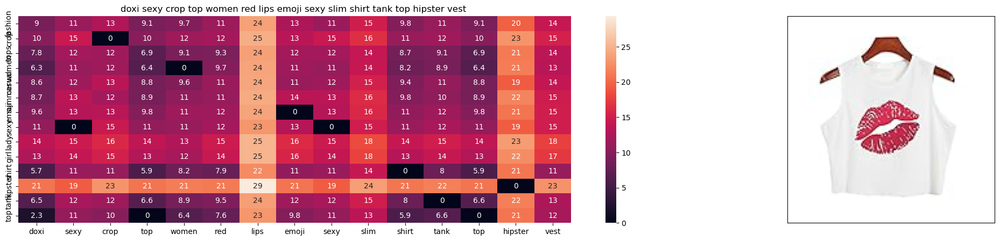

ASIN : B010TKXEHG
Brand : Doxi Supermall
euclidean distance from input : 0.2594465602527965


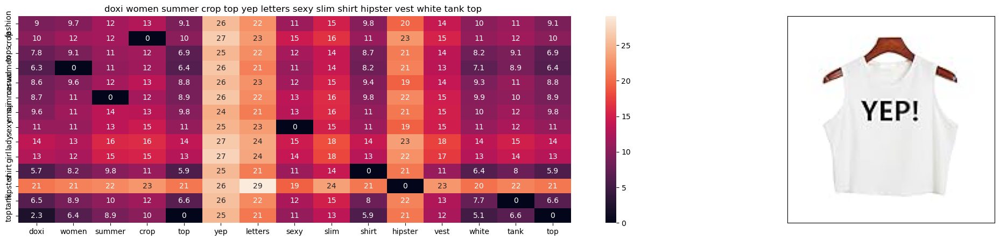

ASIN : B010V3487Q
Brand : Doxi Supermall
euclidean distance from input : 0.2669430125843395


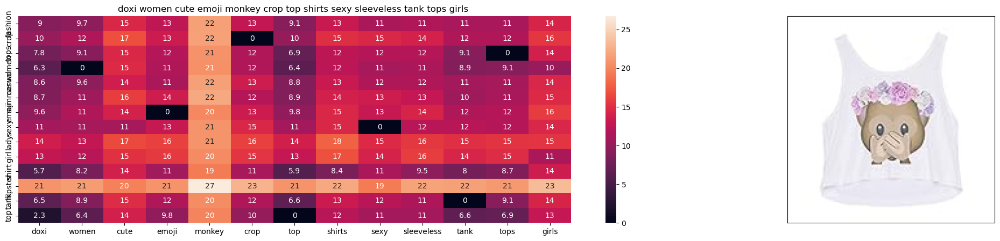

ASIN : B01LF90QTO
Brand : Doxi Supermall
euclidean distance from input : 0.2683915398337624


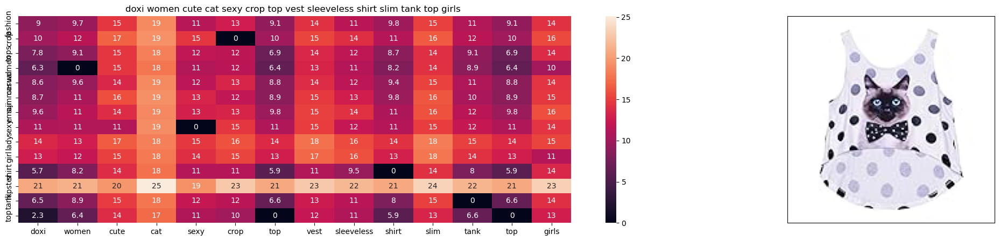

ASIN : B01LF90ROI
Brand : Doxi Supermall
euclidean distance from input : 0.26948632326993077


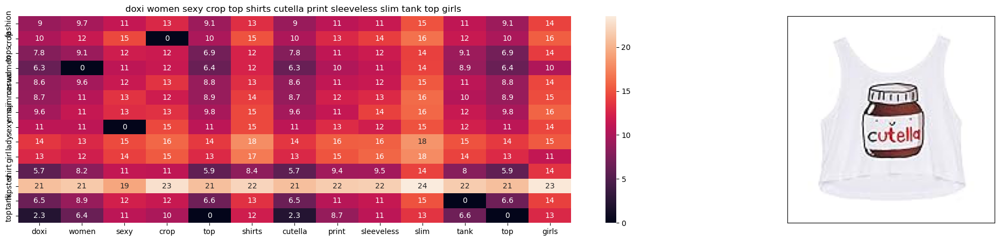

ASIN : B01LF90RKC
Brand : Doxi Supermall
euclidean distance from input : 0.2737988905473189


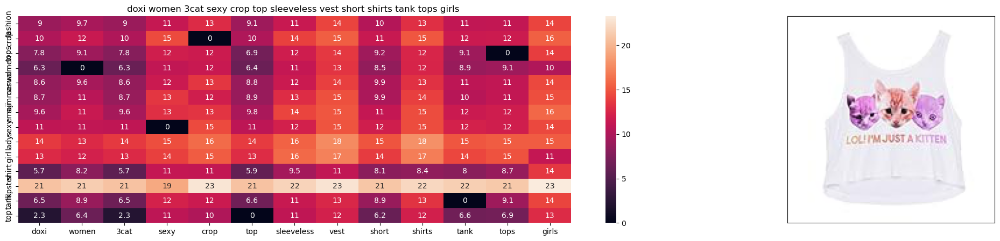

ASIN : B01LY4GQY0
Brand : Doxi Supermall
euclidean distance from input : 0.27451234297318894


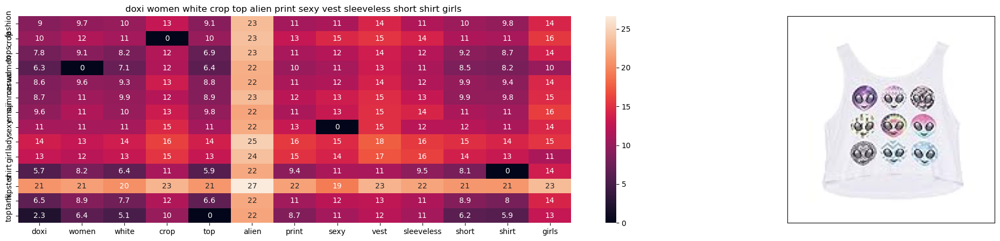

ASIN : B01LF90SCY
Brand : Doxi Supermall
euclidean distance from input : 0.28159143274480647


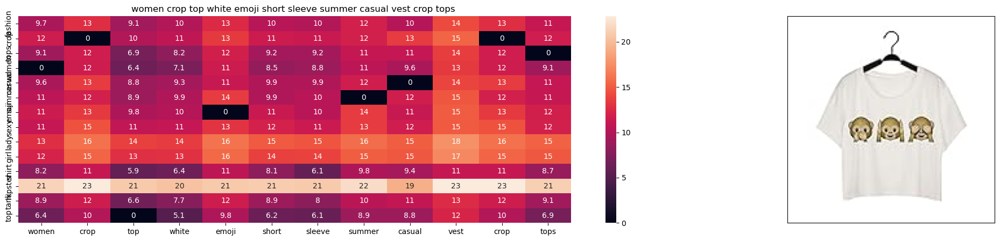

ASIN : B0124E7MHS
Brand : Doxi Supermall
euclidean distance from input : 0.2871342398903587


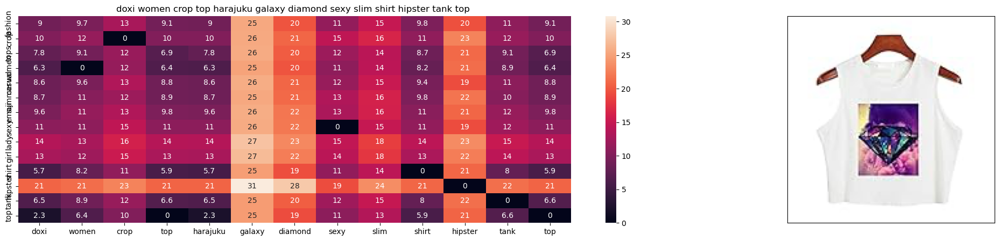

ASIN : B010V39EUM
Brand : Doxi Supermall
euclidean distance from input : 0.30813397494229405


In [154]:
# brand and color weight =50
# title vector weight = 5

idf_w2v_brand(12566, 5, 50, 20)

# Building Real World Solution

* We used BOW, TFIDF, AvgW2v, TFIDF-Word2Vec, Weighted-Averaging
> Most companies use multiple techniques

- Product<br> 
   -- BOW ----> gives some results<br> 
   -- TFIDF ---> gives some results<br>
   -- Word2Vec Bases ---> gives some results<br> 
 
 Combine all of this results and apply business rules
 <br>ex. Do not show same brand results more than twice  <br>
 ex. Give sponsered products more weights
 <hr>


# Working with images

In [ ]:
import numpy as np
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Dropout, Flatten, Dense
from keras import applications
from sklearn.metrics import pairwise_distances
import matplotlib.pyplot as plt
import requests
from PIL import Image
import pandas as pd
import pickle

In [ ]:
# https://gist.github.com/fchollet/f35fbc80e066a49d65f1688a7e99f069
# Code reference: https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html



# This code takes 40 minutes to run on a modern GPU (graphics card) 
# like Nvidia  1050.
# GPU (NVidia 1050): 0.175 seconds per image

# This codse takes 160 minutes to run on a high end i7 CPU
# CPU (i7): 0.615 seconds per image.

#Do NOT run this code unless you want to wait a few hours for it to generate output

# each image is converted into 25088 length dense-vector


'''
# dimensions of our images.
img_width, img_height = 224, 224

top_model_weights_path = 'bottleneck_fc_model.h5'
train_data_dir = 'images2/'
nb_train_samples = 16042
epochs = 50
batch_size = 1


def save_bottlebeck_features():
    
    #Function to compute VGG-16 CNN for image feature extraction.
    
    asins = []
    datagen = ImageDataGenerator(rescale=1. / 255)
    
    # build the VGG16 network
    model = applications.VGG16(include_top=False, weights='imagenet')
    generator = datagen.flow_from_directory(
        train_data_dir,
        target_size=(img_width, img_height),
        batch_size=batch_size,
        class_mode=None,
        shuffle=False)

    for i in generator.filenames:
        asins.append(i[2:-5])

    bottleneck_features_train = model.predict_generator(generator, nb_train_samples // batch_size)
    bottleneck_features_train = bottleneck_features_train.reshape((16042,25088))
    
    np.save(open('16k_data_cnn_features.npy', 'wb'), bottleneck_features_train)
    np.save(open('16k_data_cnn_feature_asins.npy', 'wb'), np.array(asins))
    

save_bottlebeck_features()

'''

In [ ]:
#load the features and corresponding ASINS info.
bottleneck_features_train = np.load('16k_data_cnn_features.npy')
asins = np.load('16k_data_cnn_feature_asins.npy')
asins = list(asins)

# load the original 16K dataset
data = pd.read_pickle('pickels/16k_apperal_data_preprocessed')
df_asins = list(data['asin'])


from IPython.display import display, Image, SVG, Math, YouTubeVideo


#get similar products using CNN features (VGG-16)
def get_similar_products_cnn(doc_id, num_results):
    doc_id = asins.index(df_asins[doc_id])
    pairwise_dist = pairwise_distances(bottleneck_features_train, bottleneck_features_train[doc_id].reshape(1,-1))

    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    for i in range(len(indices)):
        rows = data[['medium_image_url','title']].loc[data['asin']==asins[indices[i]]]
        for indx, row in rows.iterrows():
            display(Image(url=row['medium_image_url'], embed=True))
            print('Product Title: ', row['title'])
            print('Euclidean Distance from input image:', pdists[i])
            print('Amazon Url: www.amzon.com/dp/'+ asins[indices[i]])

get_similar_products_cnn(12566, 20)


> <div class="alert alert-block alert-danger">
<b>Best Results got with CNN and Word2Vec</b> 
</div>



# Measure what solution is good
**A/B Testing**

- divide users in two groups A and B
- Give one group algorithm/model1 recommendations 
- Give another group model2 recommendations
- See difference in sales or revenue to quantify which soln is better among all solns
